In [1]:
ls = [[-100,-70],[-70,-50],[-50,-20]]

In [2]:
ls

[[-100, -70], [-70, -50], [-50, -20]]

In [3]:
for j in ls:
    print(j[0],j[1])

-100 -70
-70 -50
-50 -20


In [4]:
import fil_finder
from fil_finder import FilFinder2D, Filament2D
from astropy.io import fits
from scipy.stats import norm
import copy
import pandas as pd

In [5]:
%matplotlib inline
import matplotlib.pyplot as plt
import astropy.units as u

# Optional settings for the plots. Comment out if needed.
# import seaborn as sb
# sb.set_context('poster')

import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (12., 9.6)

In [6]:
from astropy.wcs import WCS
import numpy as np
from spectral_cube import Projection
import astropy
import aplpy

In [7]:
def v2ch(v, w): # v(km/s)をchに変える
    x_tempo, y_tempo, v_tempo   = w.wcs_pix2world(0, 0, 0, 0)
    x_ch, y_ch, v_ch   = w.wcs_world2pix(x_tempo, y_tempo, v*1000.0, 0)
    v_ch = int(round(float(v_ch), 0))
    return v_ch

def del_header_key(header, keys): # headerのkeyを消す
    import copy
    h = copy.deepcopy(header)
    for k in keys:
        try:
            del h[k]
        except:
            pass
    return h
def make_new_hdu_integ(hdu, v_start_wcs, v_end_wcs, w): # 積分強度のhduを作る
    data = hdu.data
    header = hdu.header
    start_ch, end_ch = v2ch(v_start_wcs, w), v2ch(v_end_wcs, w)
    new_data = np.nansum(data[start_ch:end_ch+1], axis=0)*np.abs(header["CDELT3"])/1000.0
    header = del_header_key(header, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    header["NAXIS"] = 2
#     header["CTYPE1"] = "GLON-CAR"
#     header["CTYPE2"] = "GLAT-CAR"
    new_data[new_data==0.0]=np.nan
    try:
        header["WCSAXES"] = 2
    except:
        pass
    new_hdu = fits.PrimaryHDU(new_data, header)
    return new_hdu

In [29]:
fits_pwd = "/home/filament/Desktop/fil-test/fil_finder_fits/AIT/test_1.fits"
hdu = fits.open(fits_pwd)[0]
w = WCS(fits_pwd)

#arr = np.nanmax(hdu.data[:, :256, :256], axis=0).astype(">f4")
arr = hdu.data[468, :256, :256].astype(">f4")

In [30]:
fits_pwd.split('/')[7].split('.')[0]

'test_1'

In [13]:
hdu.header["CUNIT1"] = "deg"
hdu.header["CUNIT2"] = "deg"
hdu.header["BPA"] = 0.0
hdu.header["BMAJ"] = 0.2706
hdu.header["BMIN"] = 0.2706
hdu.header["LONPOLE"] = 0.0
hdu.header["LATPOLE"] = 90.0

In [14]:
##########
integ_hdu = make_new_hdu_integ(hdu, 20.0, 50.0, w)
##########

In [15]:
hdr1 = fits.PrimaryHDU().header
hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
# hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
# hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
hdr1["CDELT1"] = -0.01
hdr1["CDELT2"] = 0.01
hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
hdr1["BPA"] = integ_hdu.header["BPA"]
hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
hdr1["BMIN"] = integ_hdu.header["BMIN"]
hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]


In [16]:
def make_integ_filament_array(hdu,v_start,v_end,d,bmaj,cdelt,vmin,vmax):
    w = WCS(hdu)
    
    ##########################
#     wcs = WCS(hdu.header)
    ##########################
    
    
    integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
    integ_hdu.data[integ_hdu.data<=0.01]=np.nan  ####0.01
#     integ_hdu.data[integ_hdu.data<=0]=np.nan  ####0.01
    hdr1 = fits.PrimaryHDU().header
    hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
    hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
    hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
    hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
    # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
    # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
    hdr1["CDELT1"] = -cdelt
    hdr1["CDELT2"] = cdelt
    hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
    hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
    hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
    hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
    hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
    hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
    hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
    hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
#     hdr1["BPA"] = integ_hdu.header["BPA"]
#     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
#     hdr1["BMIN"] = integ_hdu.header["BMIN"]
#     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
#     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]

    
    
    fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

    fil.preprocess_image(flatten_percent=95)
    fil.create_mask(verbose=True)
    fil.medskel(verbose=True)
    fil_skeleton= fil.skeleton
    fil_skeleton = fil_skeleton.astype("int")
    hdr2 = copy.deepcopy(hdu.header)
    hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    hdr2["NAXIS"]=2
    hdr2["WCSAXES"]=2
    
    fig = aplpy.FITSFigure(integ_hdu,slices=[0])
    fig.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
    fig.add_colorbar()
    fig.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
    fig.add_grid()
    fig.set_title("%ikm/s~%ikm/s_distance = %ipc"%(v_start,v_end,d))
    fig.savefig("/home/filament/Downloads/fil_remake/%i_%i_%i.png"%(v_start,v_end,d))
    integ_hdu.writeto("/home/filament/Downloads/fil_remake/%s_%i_%i.fits"%(fits_pwd.split('/')[6].split('.')[0],v_start,v_end), overwrite=True)
    
    
#     plt.clf()
    
#     fil.analyze_skeletons()
#     fil.exec_rht()
    
#     ypos = np.array([f.position()[0].value for f in fil.filaments])
    
#     ########################################
    
# #     print(fil.filaments[0].position())
# #     print(w.wcs_pix2world(fil.filaments[0].position()[0],fil.filaments[0].position()[1],0,0))
# #     print(fil.filaments[0].orientation)
# #     print(w.wcs_pix2world(fil.filaments[0].position()[0],fil.filaments[0].position()[1],0))
#     ########################################

#     ori = np.array(np.rad2deg(fil.orientation))
#     ori2 = ori
#     ori2 = ori2[ypos<=800]
#     plt.hist(ori2,alpha=0.5,bins=np.linspace(-90,90,num=18))
#     plt.savefig("/home/filament/Downloads/fil_remake/%i_%i_%i_hist.png"%(v_start,v_end,d))

region 1

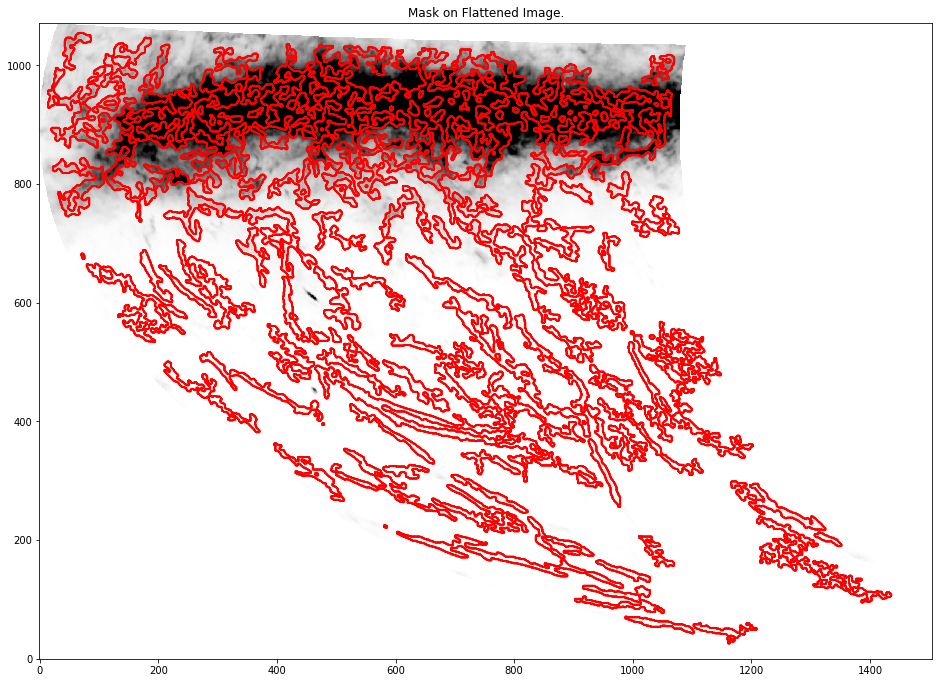

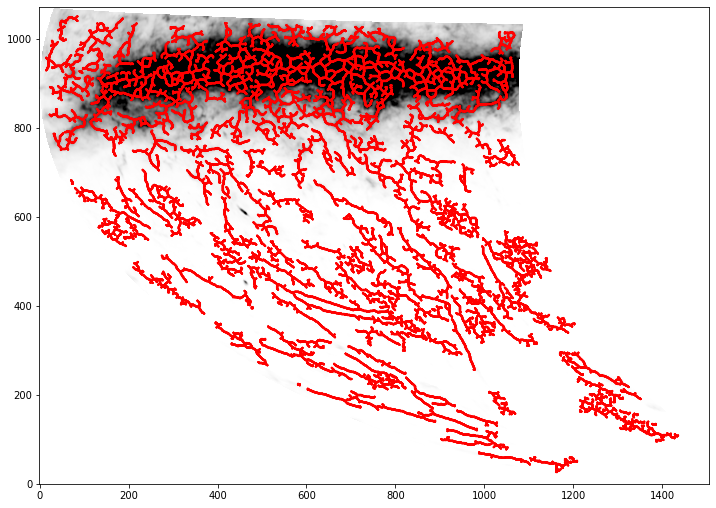

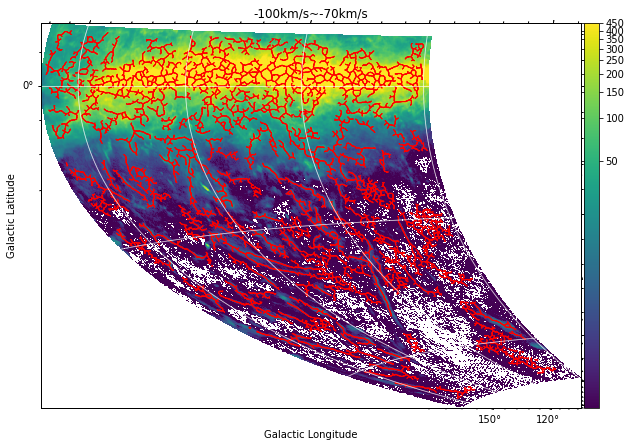

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


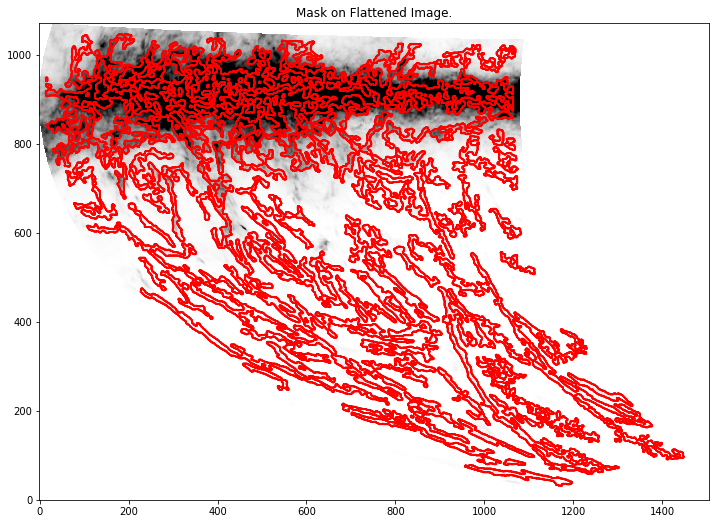

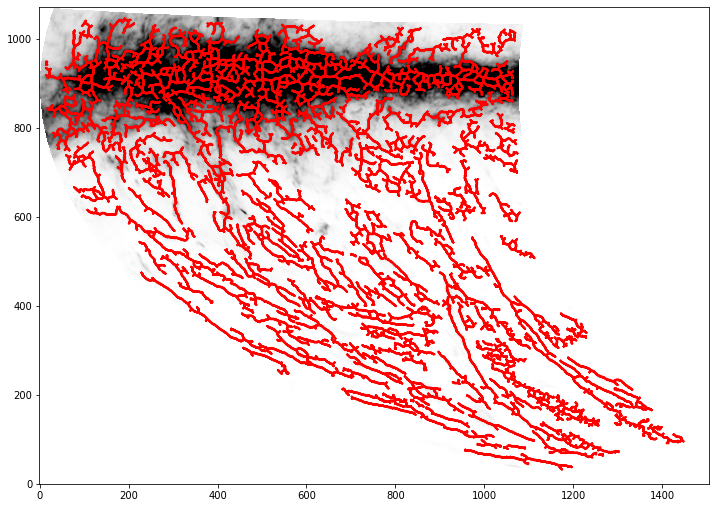

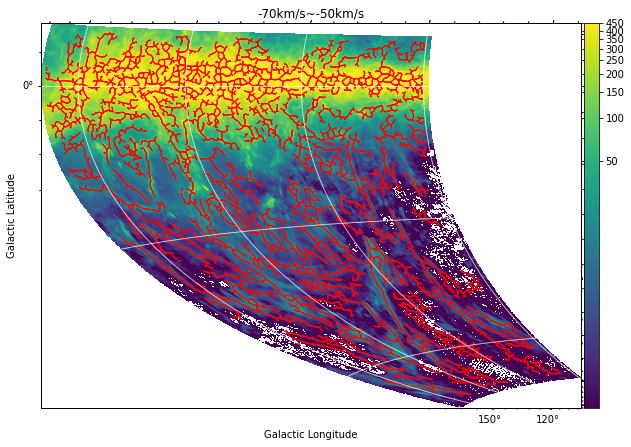

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


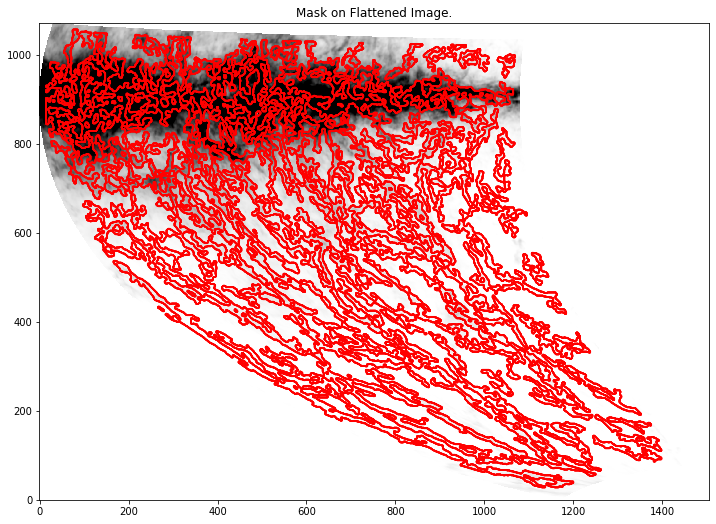

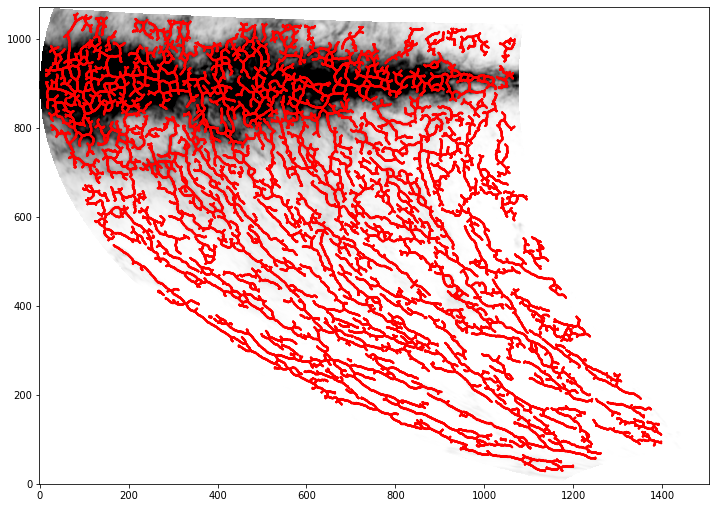

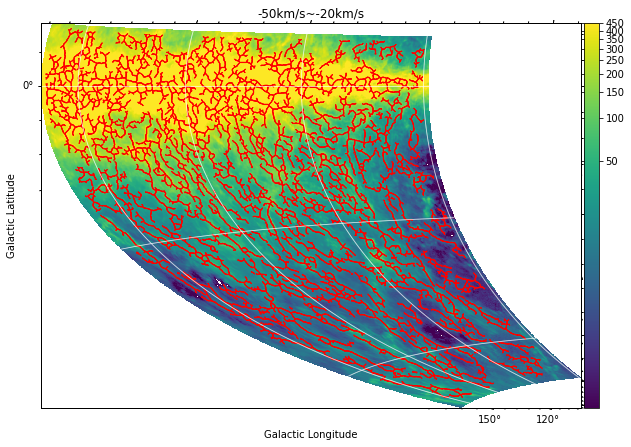

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


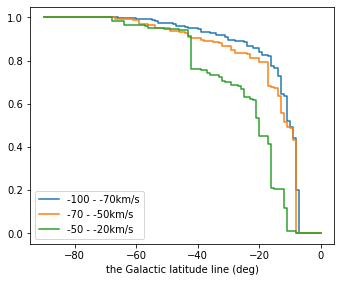

In [17]:
ls = [[-100,-70],[-70,-50],[-50,-20]]
ruiseki_ls = []
fil_to_b = []

fig_ls = []

fig = plt.figure(figsize=(16,16))
for i,j in enumerate(ls):
    
    w = WCS(hdu)


    v_start,v_end,d,bmaj,cdelt,vmin,vmax = j[0],j[1],10,0.2706,0.083333333,1,450
    ##########################
    #     wcs = WCS(hdu.header)
    ##########################


    integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
    integ_hdu.data[integ_hdu.data<=0.01]=np.nan  ####0.01
    hdr1 = fits.PrimaryHDU().header
    hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
    hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
    hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
    hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
    # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
    # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
    hdr1["CDELT1"] = -cdelt
    hdr1["CDELT2"] = cdelt
    hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
    hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
    hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
    hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
    hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
    hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
    hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
    hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
    #     hdr1["BPA"] = integ_hdu.header["BPA"]
    #     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
    #     hdr1["BMIN"] = integ_hdu.header["BMIN"]
    #     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
    #     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



    fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

    fil.preprocess_image(flatten_percent=95)
    fil.create_mask(verbose=True)
    fil.medskel(verbose=True)
    fil_skeleton= fil.skeleton
    fil_skeleton = fil_skeleton.astype("int")
    hdr2 = copy.deepcopy(hdu.header)
    hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    hdr2["NAXIS"]=2
    hdr2["WCSAXES"]=2

    fig_ = aplpy.FITSFigure(integ_hdu,slices=[0])
    fig_.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
    fig_.add_colorbar()
    fig_.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
    fig_.add_grid()
    fig_.set_title("%ikm/s~%ikm/s"%(v_start,v_end))
    fig_.savefig("/home/filament/Downloads/fil_remake/%s_%i_%i.png"%(fits_pwd.split('/')[6].split('.')[0],v_start,v_end))
    integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)
    fig_ls.append(fig_)
    plt.show()


#     plt.clf()

    fil.analyze_skeletons()
    fil.exec_rht()
    fil.find_widths(max_dist=10 * u.pix)
    total_intensity_arr = fil.total_intensity()

    ypos = np.array([f.position()[0].value for f in fil.filaments])
    
    
    ruiseki = []
    for k in range(-90,1):
        c = 0.0
        for j,f in enumerate(fil.filaments):
            if f.position()[0].value>800:
                continue
            pos = w.wcs_pix2world(f.position()[1],f.position()[0],0,0)
            
            if pos[1] > k:
                
                c += total_intensity_arr[j]
        ruiseki.append(c)
    ruiseki_ls.append(ruiseki)
#             pos = w.wcs_pix2world(i.position()[1],i.position()[0],0,0)   #return:(l,b)


#             coo_ls.append(pos)
#             b_ls.append(pos[1])

ax1 = plt.subplot(2,2,1)


ax1.step(range(-90,1),ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "-100 - -70km/s")
ax1.step(range(-90,1),ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "-70 - -50km/s")
ax1.step(range(-90,1),ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "-50 - -20km/s")
ax1.set_xlabel("the Galactic latitude line (deg)")
ax1.set_ylabel("")
ax1.legend()  
        
plt.show()
    
#     coo_ls = []
#     b_ls = []
#     for i in fil.filaments:
#         if j.position()[0].value<400:
#             continue
#         pos = w.wcs_pix2world(j.position()[1],j.position()[0],0,0)   #return:(l,b)

#         coo_ls.append(pos)
#         b_ls.append(pos[1])
        
        
#     b_ls_ = []
#     for i in b_ls:
#         b_ls_.append(i)
    
#     b_ls_array = np.array(b_ls_)
    
#     fil_to_b.append(b_ls_array)
    
    


In [17]:
fil.filaments[0].position()

[<Quantity 53. pix>, <Quantity 1101. pix>]

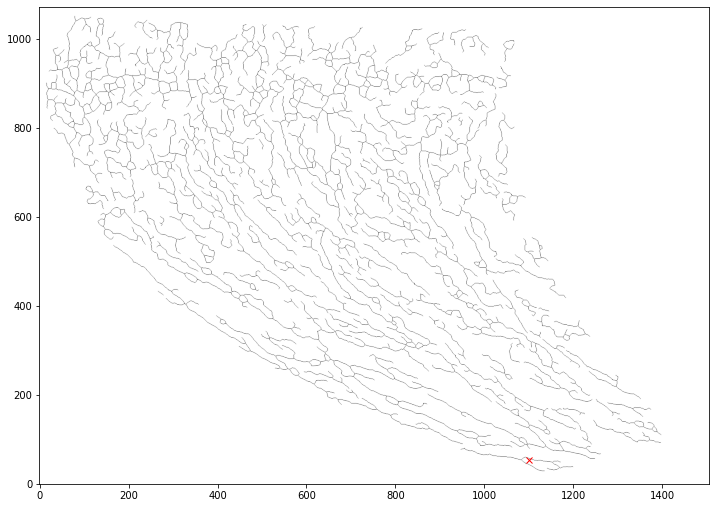

In [23]:
plt.imshow(fil.skeleton,origin="lower",cmap="Greys")
plt.plot(fil.filaments[0].position()[1],fil.filaments[0].position()[0],color="red",marker="x")

-2

In [39]:
b_ls = []
for i in range(-90,1):
        b_ls.append(i)
b_ls = b_ls[::-1]

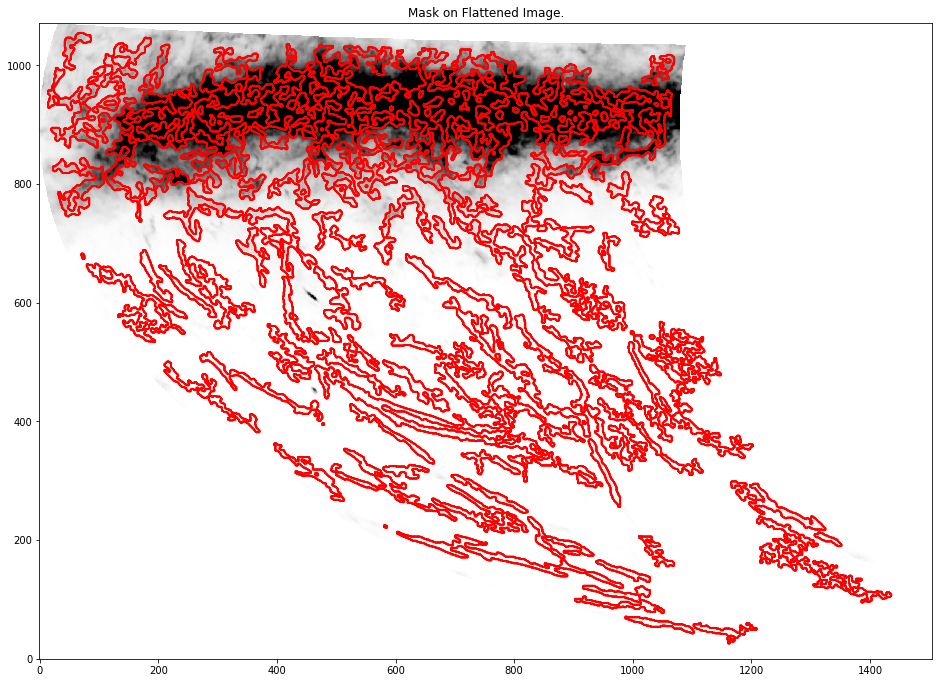

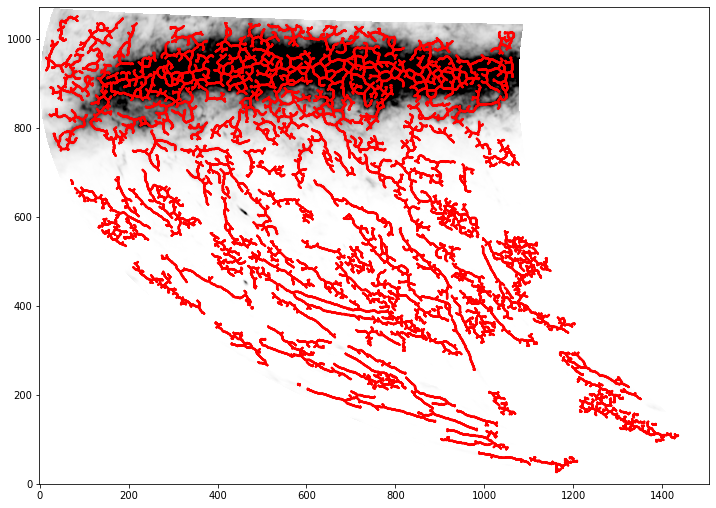

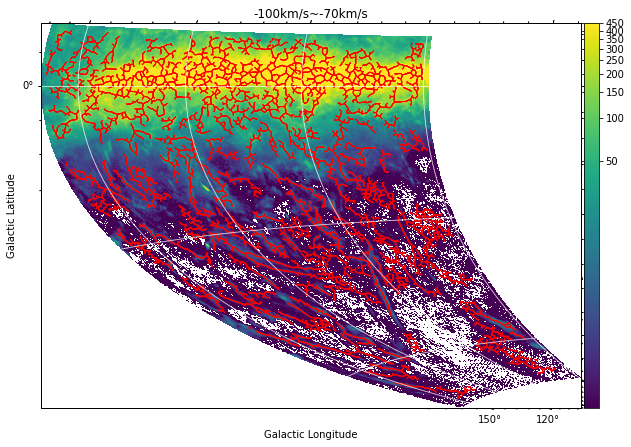

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


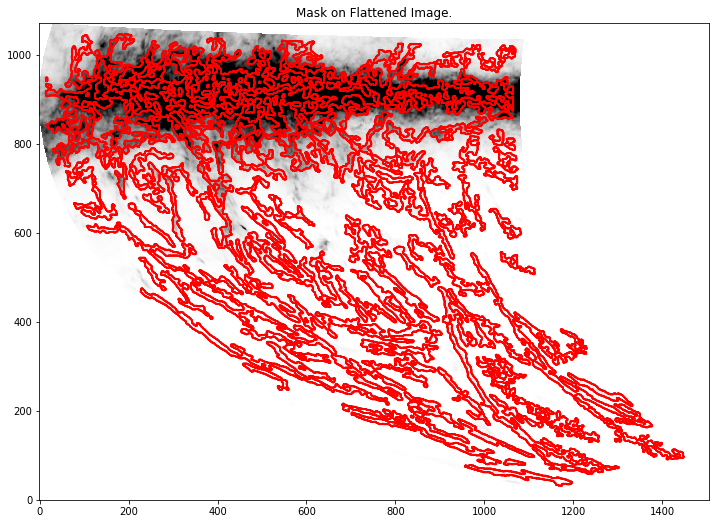

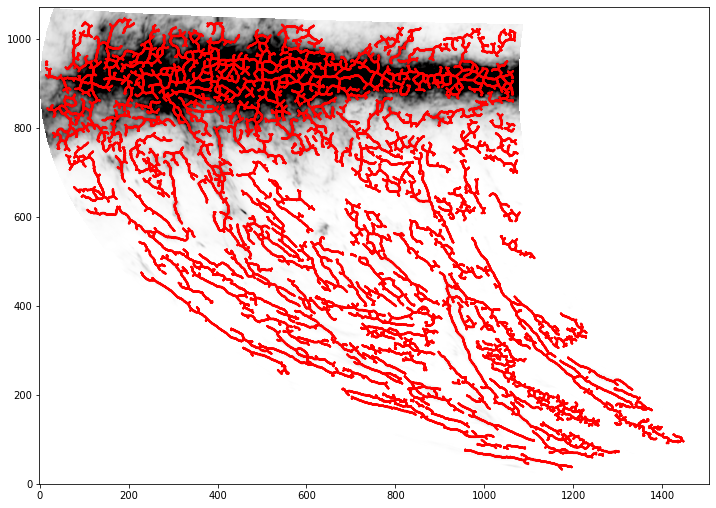

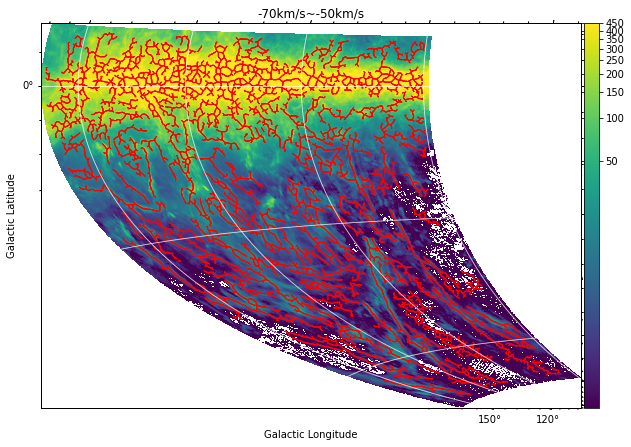

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"


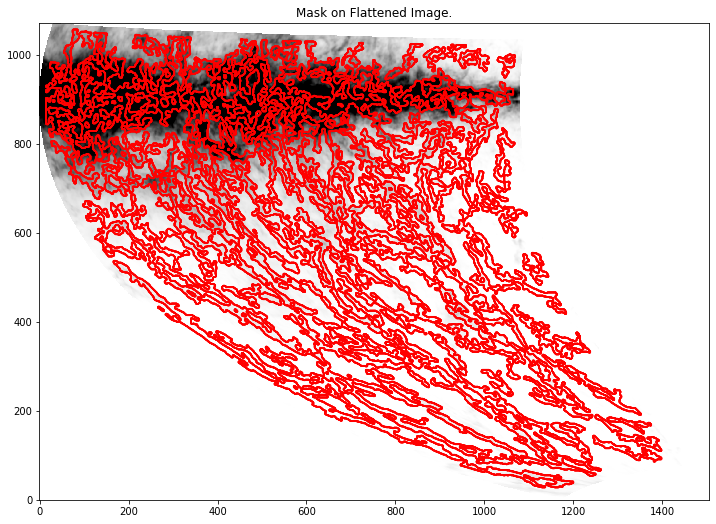

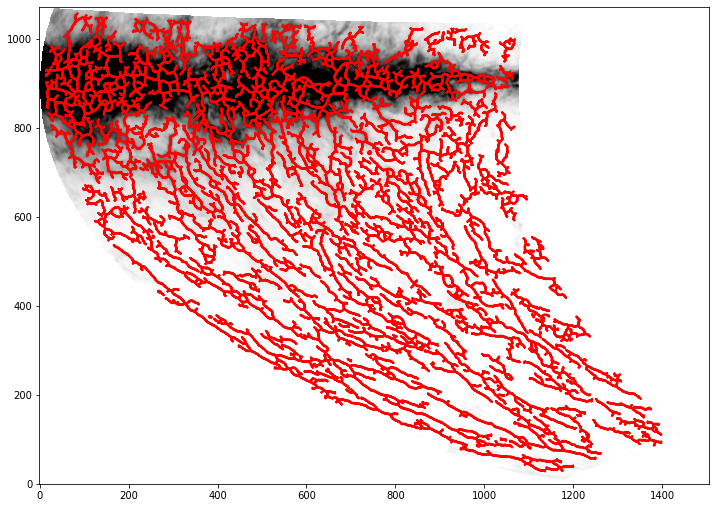

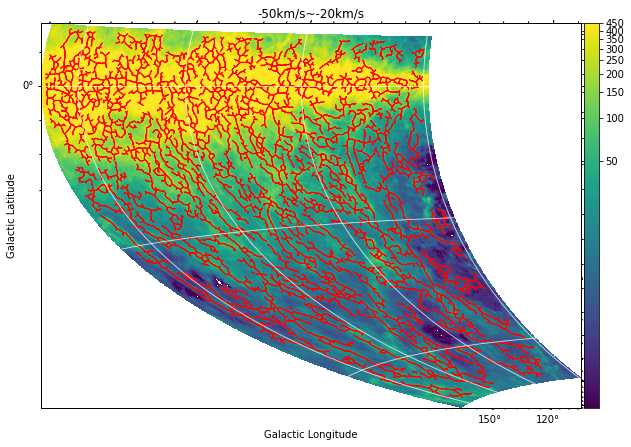

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


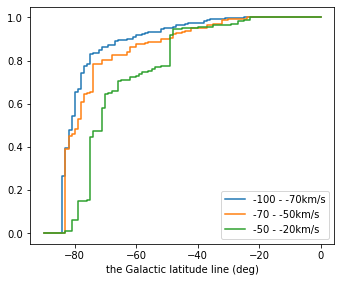

In [18]:
ls = [[-100,-70],[-70,-50],[-50,-20]]
ruiseki_ls = []
fil_to_b = []

fig_ls = []

b_ls = []

for i in range(-90,1):
        b_ls.append(i)
b_ls = b_ls[::-1]

fig = plt.figure(figsize=(16,16))
for i,j in enumerate(ls):
    
    w = WCS(hdu)


    v_start,v_end,d,bmaj,cdelt,vmin,vmax = j[0],j[1],10,0.2706,0.083333333,1,450
    ##########################
    #     wcs = WCS(hdu.header)
    ##########################


    integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
    integ_hdu.data[integ_hdu.data<=0.01]=np.nan  ####0.01
    hdr1 = fits.PrimaryHDU().header
    hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
    hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
    hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
    hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
    # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
    # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
    hdr1["CDELT1"] = -cdelt
    hdr1["CDELT2"] = cdelt
    hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
    hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
    hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
    hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
    hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
    hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
    hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
    hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
    #     hdr1["BPA"] = integ_hdu.header["BPA"]
    #     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
    #     hdr1["BMIN"] = integ_hdu.header["BMIN"]
    #     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
    #     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



    fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

    fil.preprocess_image(flatten_percent=95)
    fil.create_mask(verbose=True)
    fil.medskel(verbose=True)
    fil_skeleton= fil.skeleton
    fil_skeleton = fil_skeleton.astype("int")
    hdr2 = copy.deepcopy(hdu.header)
    hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    hdr2["NAXIS"]=2
    hdr2["WCSAXES"]=2

#     fig_ = aplpy.FITSFigure(integ_hdu,slices=[0],figure=fig,subplot=(2,2,i+2))
    fig_ = aplpy.FITSFigure(integ_hdu,slices=[0])
    fig_.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
    fig_.add_colorbar()
    fig_.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
    fig_.add_grid()
    fig_.set_title("%ikm/s~%ikm/s"%(v_start,v_end))
    fig_.savefig("/home/filament/Downloads/fil_remake/%s_%i_%i.png"%(fits_pwd.split('/')[6].split('.')[0],v_start,v_end))
    integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)
    fig_ls.append(fig_)
    plt.show()


#     plt.clf()

    fil.analyze_skeletons()
    fil.exec_rht()
    fil.find_widths(max_dist=10 * u.pix)
    total_intensity_arr = fil.total_intensity()

    ypos = np.array([f.position()[0].value for f in fil.filaments])
    
    
    ruiseki = []
    

        
    for k in b_ls:
        c = 0.0
        for j,f in enumerate(fil.filaments):
            if f.position()[0].value>800:
                continue
            pos = w.wcs_pix2world(f.position()[1],f.position()[0],0,0)
            
            if pos[1] > k:
                
                c += total_intensity_arr[j]
        ruiseki.append(c)
    ruiseki_ls.append(ruiseki)
#             pos = w.wcs_pix2world(i.position()[1],i.position()[0],0,0)   #return:(l,b)


#             coo_ls.append(pos)
#             b_ls.append(pos[1])

ax1 = plt.subplot(2,2,1)


ax1.step(range(-90,1),ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "-100 - -70km/s")
ax1.step(range(-90,1),ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "-70 - -50km/s")
ax1.step(range(-90,1),ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "-50 - -20km/s")


ax1.set_xlabel("the Galactic latitude line (deg)")
ax1.set_ylabel("")
ax1.legend()  
        
plt.show()
    
#     coo_ls = []
#     b_ls = []
#     for i in fil.filaments:
#         if j.position()[0].value<400:
#             continue
#         pos = w.wcs_pix2world(j.position()[1],j.position()[0],0,0)   #return:(l,b)

#         coo_ls.append(pos)
#         b_ls.append(pos[1])
        
        
#     b_ls_ = []
#     for i in b_ls:
#         b_ls_.append(i)
    
#     b_ls_array = np.array(b_ls_)
    
#     fil_to_b.append(b_ls_array)
    
    


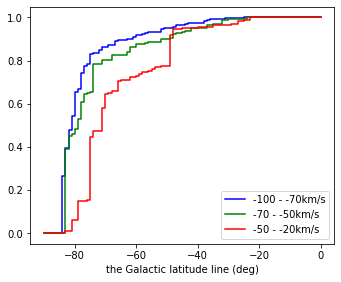

In [23]:
ax1 = plt.subplot(2,2,1)


ax1.step(range(-90,1),ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "-100 - -70km/s",color = "blue")
ax1.step(range(-90,1),ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "-70 - -50km/s",color = "Green")
ax1.step(range(-90,1),ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "-50 - -20km/s",color = "red")


ax1.set_xlabel("the Galactic latitude line (deg)")
ax1.set_ylabel("")
ax1.legend()  
        
plt.show()

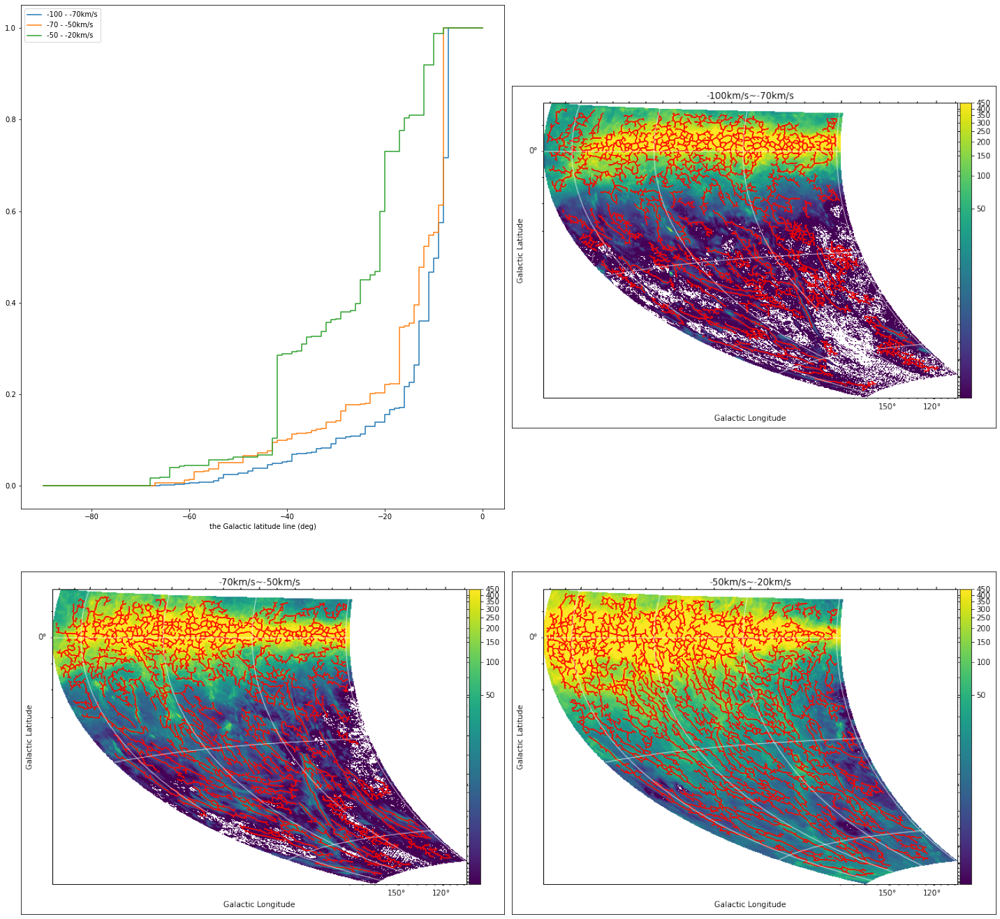

In [16]:
a = plt.imread("/home/filament/Downloads/fil_remake/test_1_-100_-70.png")
b = plt.imread("/home/filament/Downloads/fil_remake/test_1_-70_-50.png")
c = plt.imread("/home/filament/Downloads/fil_remake/test_1_-50_-20.png")
fig = plt.figure(figsize=(20,20))
ax1 = plt.subplot(2,2,2)
ax2 = plt.subplot(2,2,3)
ax3 = plt.subplot(2,2,4)

ax0 = plt.subplot(2,2,1)


ax0.step(range(-90,1),ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "-100 - -70km/s")
ax0.step(range(-90,1),ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "-70 - -50km/s")
ax0.step(range(-90,1),ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "-50 - -20km/s")
ax0.set_xlabel("the Galactic latitude line (deg)")
ax0.set_ylabel("")
ax0.legend()



ax1.imshow(a)
ax2.imshow(b)
ax3.imshow(c)
ax1.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax2.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax3.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)

plt.tight_layout()

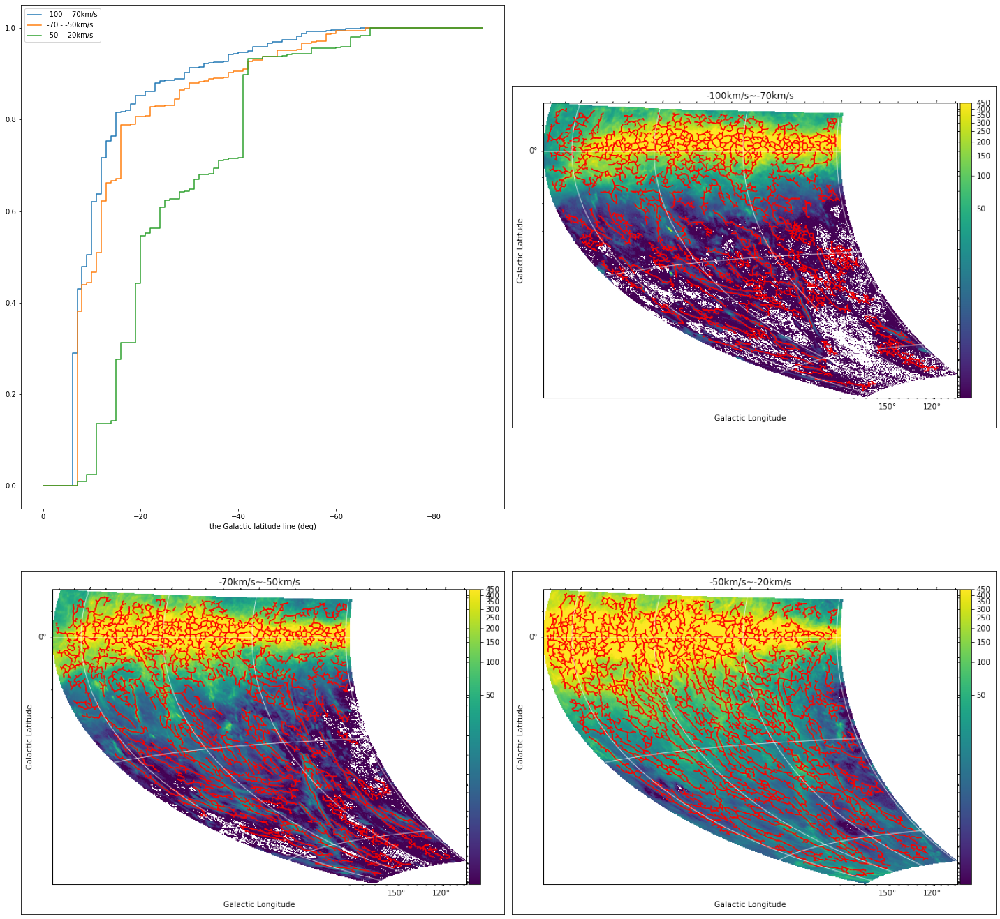

In [12]:

a = plt.imread("/home/filament/Downloads/fil_remake/test_1_-100_-70.png")
b = plt.imread("/home/filament/Downloads/fil_remake/test_1_-70_-50.png")
c = plt.imread("/home/filament/Downloads/fil_remake/test_1_-50_-20.png")
fig = plt.figure(figsize=(20,20))
ax1 = plt.subplot(2,2,2)
ax2 = plt.subplot(2,2,3)
ax3 = plt.subplot(2,2,4)

ax0 = plt.subplot(2,2,1)


ax0.step(b_ls,ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "-100 - -70km/s")

ax0.step(b_ls,ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "-70 - -50km/s")

ax0.step(b_ls,ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "-50 - -20km/s")

ax0.invert_xaxis()


ax0.set_xlabel("the Galactic latitude line (deg)")
ax0.set_ylabel("")
ax0.legend()



ax1.imshow(a)
ax2.imshow(b)
ax3.imshow(c)
ax1.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax2.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax3.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)

plt.tight_layout()

region2

In [31]:
fits_pwd = "/home/filament/Desktop/fil-test/fil_finder_fits/AIT/test_2.fits"
hdu = fits.open(fits_pwd)[0]
w = WCS(fits_pwd)

#arr = np.nanmax(hdu.data[:, :256, :256], axis=0).astype(">f4")
arr = hdu.data[468, :256, :256].astype(">f4")


In [32]:
fits_pwd.split('/')[7].split('.')[0]

'test_2'

In [33]:
hdu.header["CUNIT1"] = "deg"
hdu.header["CUNIT2"] = "deg"
hdu.header["BPA"] = 0.0
hdu.header["BMAJ"] = 0.2706
hdu.header["BMIN"] = 0.2706
hdu.header["LONPOLE"] = 0.0
hdu.header["LATPOLE"] = 90.0

In [34]:
##########
integ_hdu = make_new_hdu_integ(hdu, 20.0, 50.0, w)
##########

In [35]:
hdr1 = fits.PrimaryHDU().header
hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
# hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
# hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
hdr1["CDELT1"] = -0.01
hdr1["CDELT2"] = 0.01
hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
hdr1["BPA"] = integ_hdu.header["BPA"]
hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
hdr1["BMIN"] = integ_hdu.header["BMIN"]
hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]


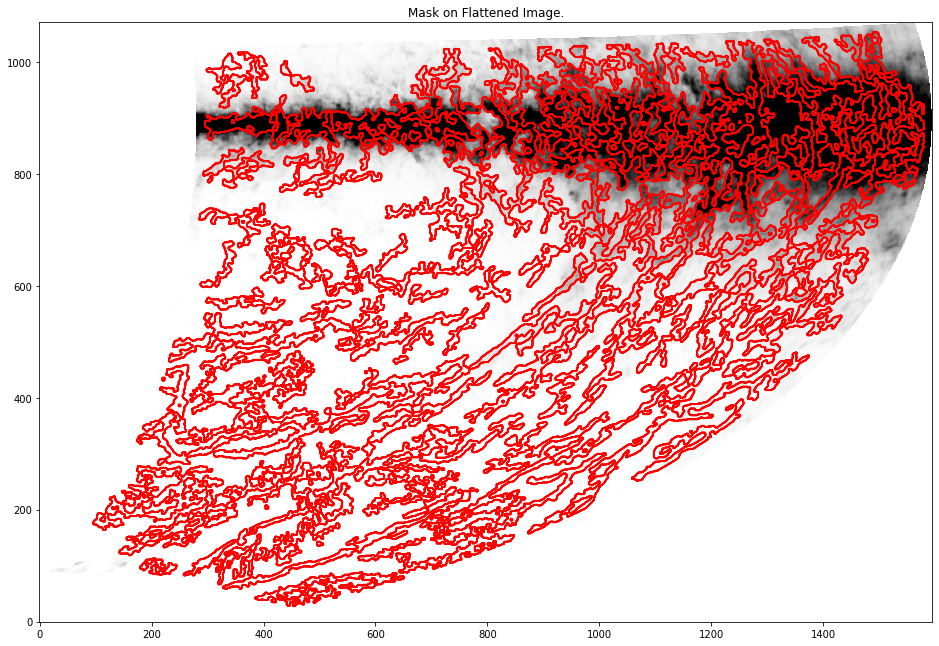

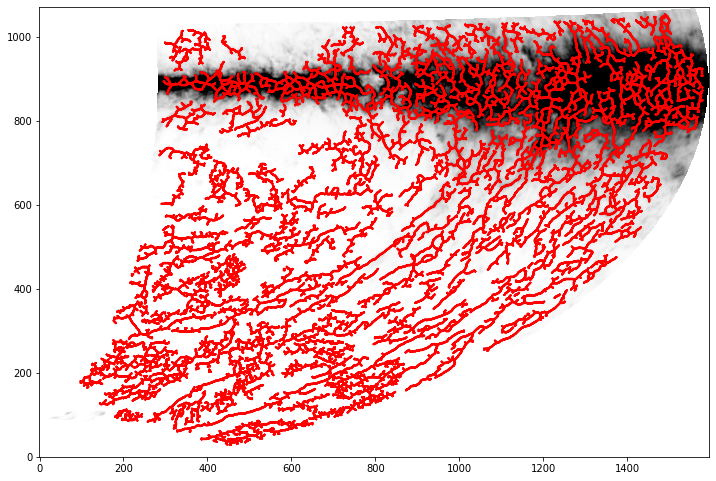

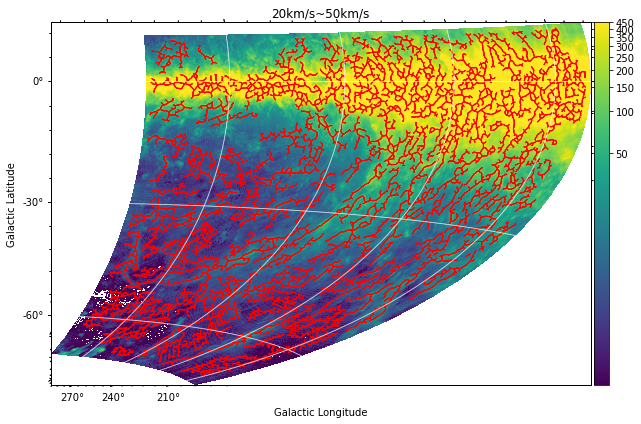

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


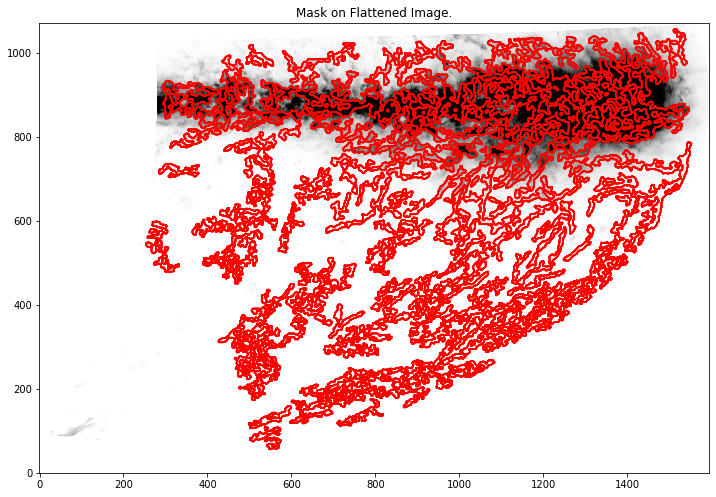

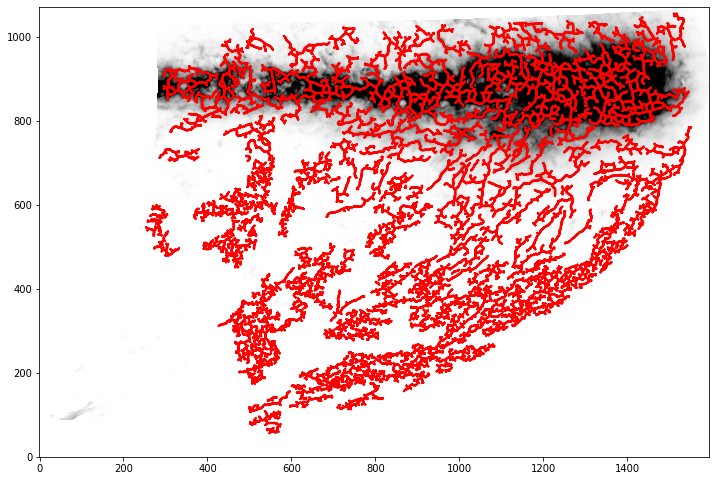

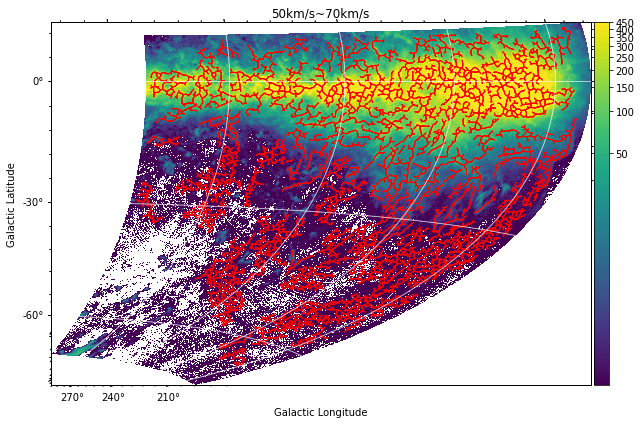

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/sit

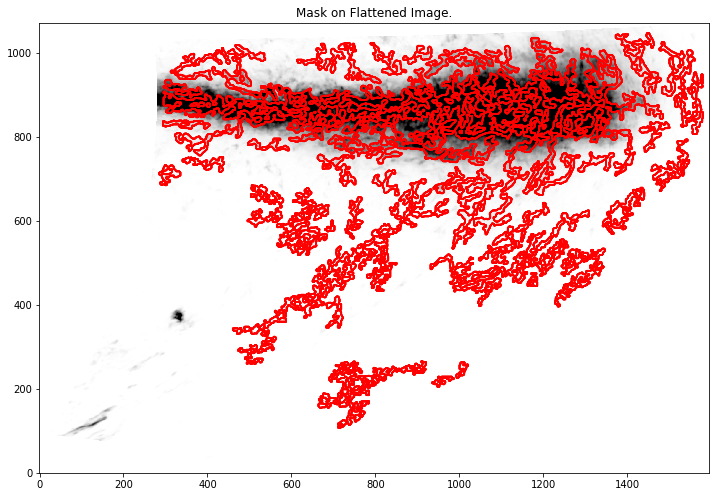

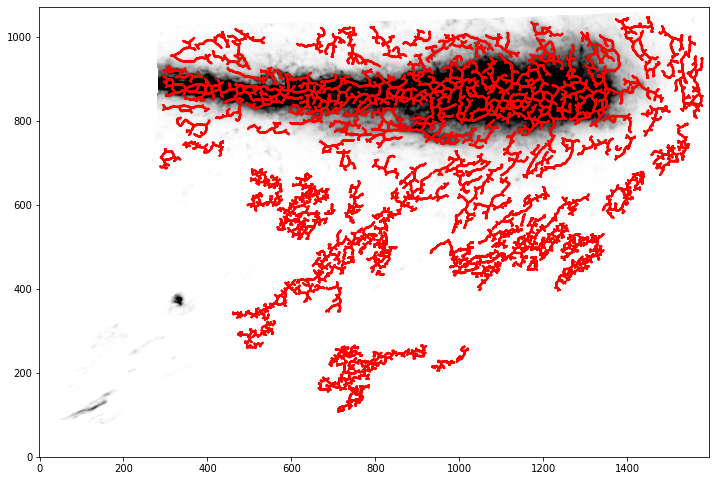

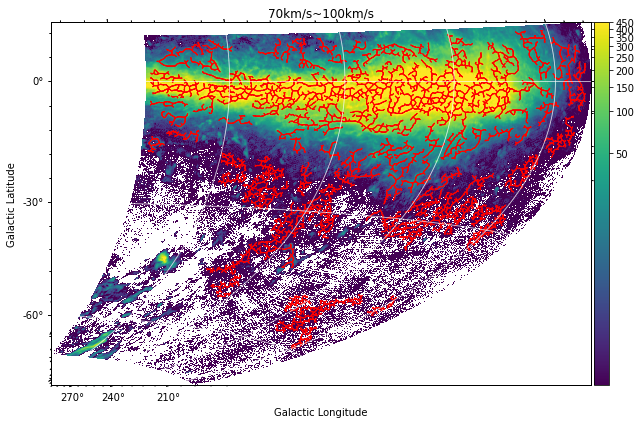

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/sit

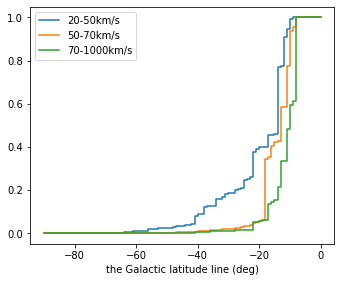

In [36]:
ls = [[20,50],[50,70],[70,100]]
ruiseki_ls = []
fil_to_b = []

fig_ls = []

fig = plt.figure(figsize=(16,16))
for i,j in enumerate(ls):
    
    w = WCS(hdu)


    v_start,v_end,d,bmaj,cdelt,vmin,vmax = j[0],j[1],10,0.2706,0.083333333,1,450
    ##########################
    #     wcs = WCS(hdu.header)
    ##########################


    integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
    integ_hdu.data[integ_hdu.data<=0.01]=np.nan  ####0.01
    hdr1 = fits.PrimaryHDU().header
    hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
    hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
    hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
    hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
    # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
    # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
    hdr1["CDELT1"] = -cdelt
    hdr1["CDELT2"] = cdelt
    hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
    hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
    hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
    hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
    hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
    hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
    hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
    hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
    #     hdr1["BPA"] = integ_hdu.header["BPA"]
    #     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
    #     hdr1["BMIN"] = integ_hdu.header["BMIN"]
    #     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
    #     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



    fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

    fil.preprocess_image(flatten_percent=95)
    fil.create_mask(verbose=True)
    fil.medskel(verbose=True)
    fil_skeleton= fil.skeleton
    fil_skeleton = fil_skeleton.astype("int")
    hdr2 = copy.deepcopy(hdu.header)
    hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    hdr2["NAXIS"]=2
    hdr2["WCSAXES"]=2

    fig_ = aplpy.FITSFigure(integ_hdu,slices=[0])
    fig_.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
    fig_.add_colorbar()
    fig_.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
    fig_.add_grid()
    fig_.set_title("%ikm/s~%ikm/s"%(v_start,v_end))
    fig_.savefig("/home/filament/Downloads/fil_remake/%s_%i_%i.png"%(fits_pwd.split('/')[6].split('.')[0],v_start,v_end))
    integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)
    fig_ls.append(fig_)
    plt.show()


#     plt.clf()

    fil.analyze_skeletons()
    fil.exec_rht()
    fil.find_widths(max_dist=10 * u.pix)
    total_intensity_arr = fil.total_intensity()

    ypos = np.array([f.position()[0].value for f in fil.filaments])
    
    
    ruiseki = []
    for k in range(-90,1):
        c = 0.0
        for j,f in enumerate(fil.filaments):
            if f.position()[0].value>800:
                continue
            pos = w.wcs_pix2world(f.position()[1],f.position()[0],0,0)
            
            if pos[1] < k:
                
                c += total_intensity_arr[j]
        ruiseki.append(c)
    ruiseki_ls.append(ruiseki)
#             pos = w.wcs_pix2world(i.position()[1],i.position()[0],0,0)   #return:(l,b)


#             coo_ls.append(pos)
#             b_ls.append(pos[1])

ax1 = plt.subplot(2,2,1)


ax1.step(range(-90,1),ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "20-50km/s")
ax1.step(range(-90,1),ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "50-70km/s")
ax1.step(range(-90,1),ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "70-1000km/s")
ax1.set_xlabel("the Galactic latitude line (deg)")
ax1.set_ylabel("")
ax1.legend()  
        
plt.show()
    
#     coo_ls = []
#     b_ls = []
#     for i in fil.filaments:
#         if j.position()[0].value<400:
#             continue
#         pos = w.wcs_pix2world(j.position()[1],j.position()[0],0,0)   #return:(l,b)

#         coo_ls.append(pos)
#         b_ls.append(pos[1])
        
        
#     b_ls_ = []
#     for i in b_ls:
#         b_ls_.append(i)
    
#     b_ls_array = np.array(b_ls_)
    
#     fil_to_b.append(b_ls_array)
    
    


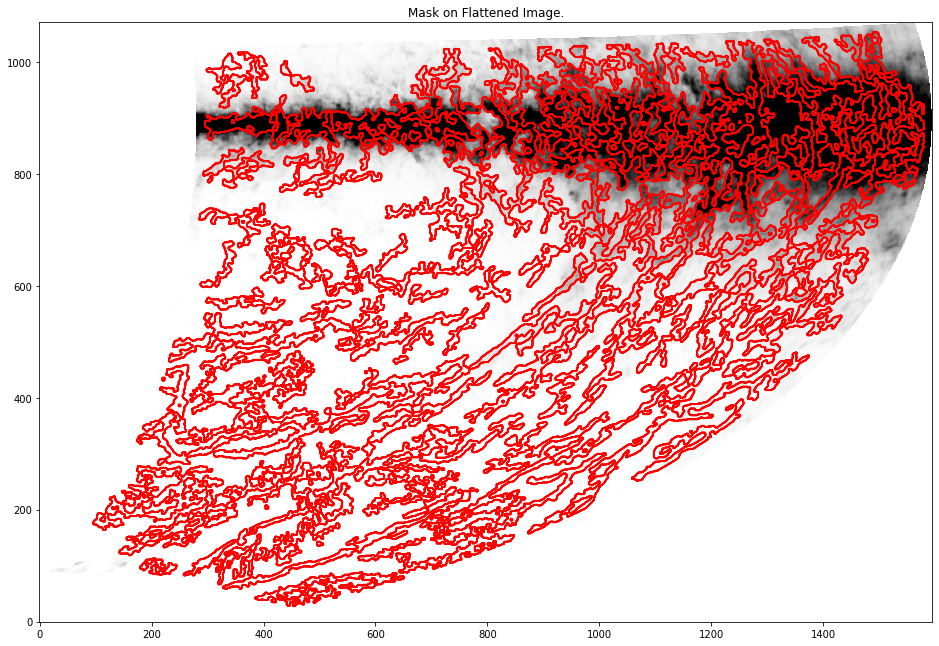

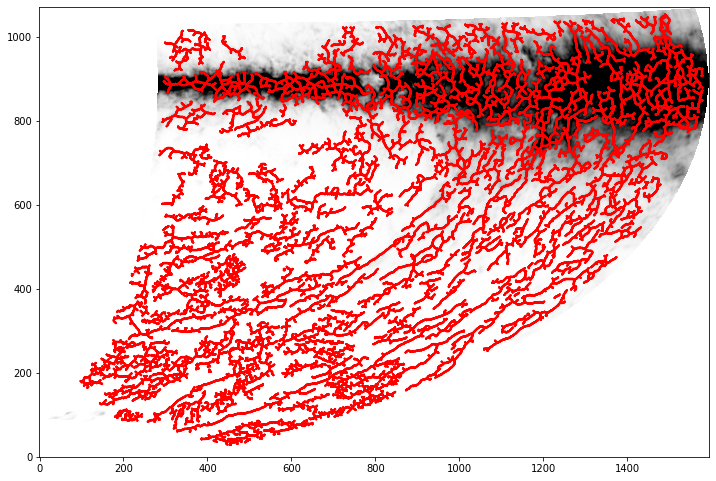

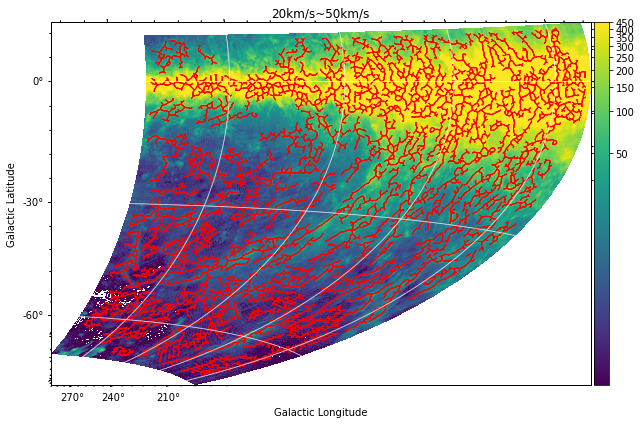

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


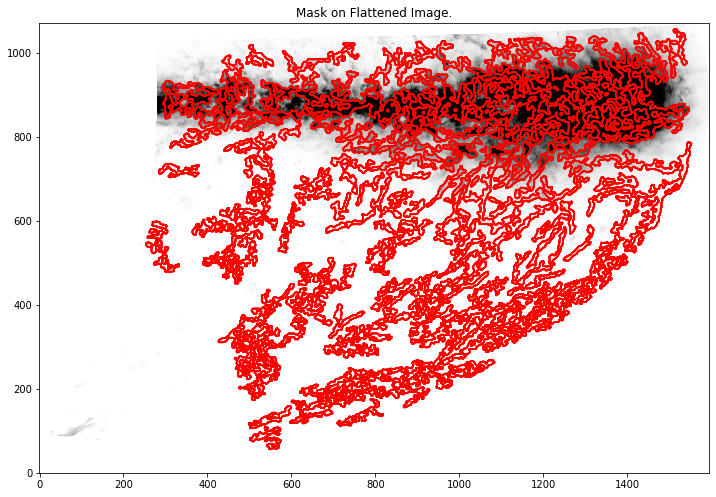

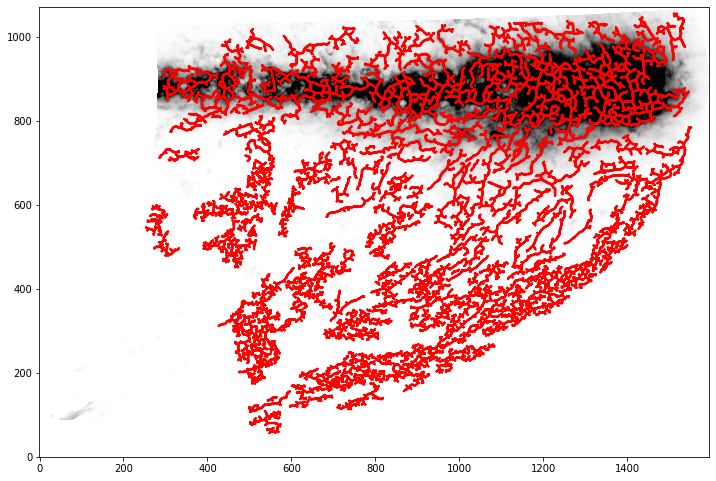

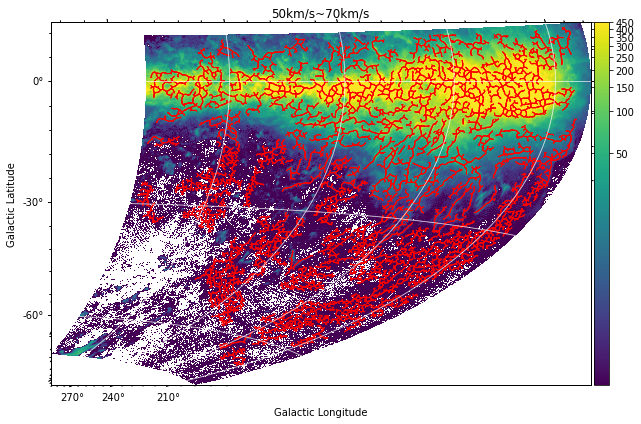

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"


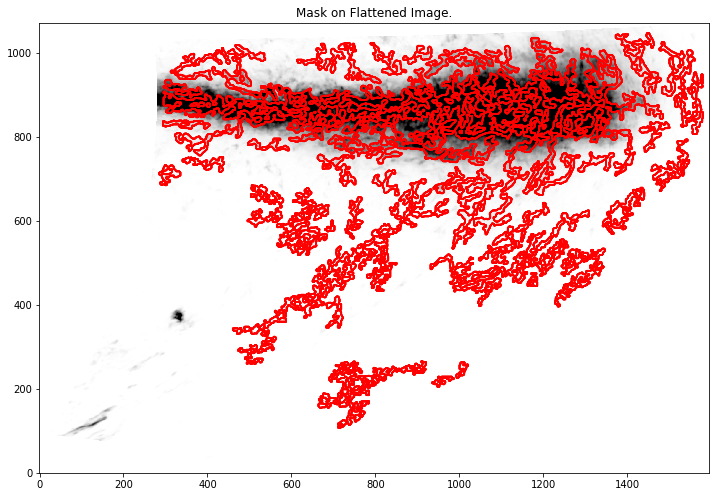

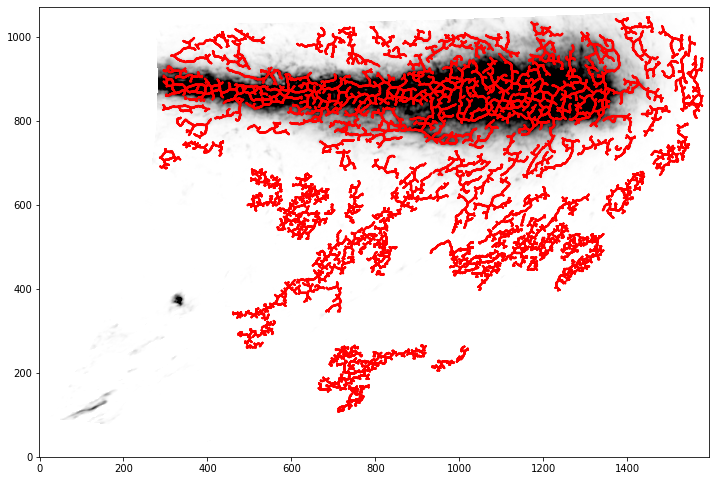

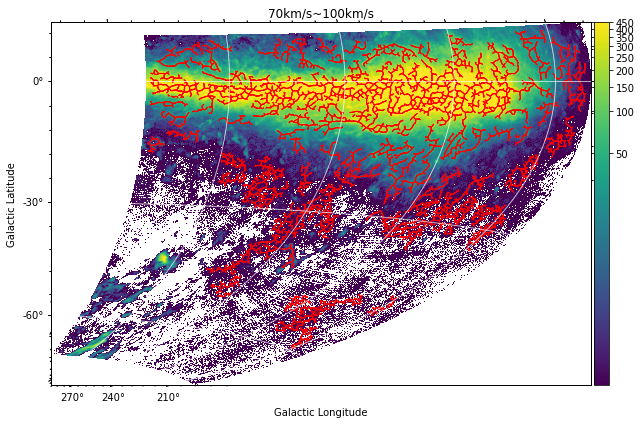

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/sit

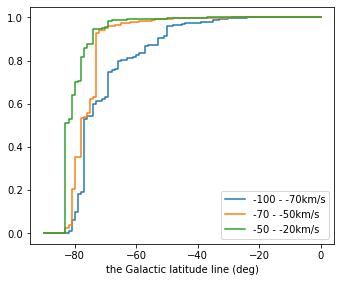

In [18]:
ls = [[20,50],[50,70],[70,100]]
ruiseki_ls = []
fil_to_b = []

fig_ls = []

b_ls = []

for i in range(-90,1):
        b_ls.append(i)
b_ls = b_ls[::-1]

fig = plt.figure(figsize=(16,16))
for i,j in enumerate(ls):
    
    w = WCS(hdu)


    v_start,v_end,d,bmaj,cdelt,vmin,vmax = j[0],j[1],10,0.2706,0.083333333,1,450
    ##########################
    #     wcs = WCS(hdu.header)
    ##########################


    integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
    integ_hdu.data[integ_hdu.data<=0.01]=np.nan  ####0.01
    hdr1 = fits.PrimaryHDU().header
    hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
    hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
    hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
    hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
    # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
    # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
    hdr1["CDELT1"] = -cdelt
    hdr1["CDELT2"] = cdelt
    hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
    hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
    hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
    hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
    hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
    hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
    hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
    hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
    #     hdr1["BPA"] = integ_hdu.header["BPA"]
    #     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
    #     hdr1["BMIN"] = integ_hdu.header["BMIN"]
    #     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
    #     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



    fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

    fil.preprocess_image(flatten_percent=95)
    fil.create_mask(verbose=True)
    fil.medskel(verbose=True)
    fil_skeleton= fil.skeleton
    fil_skeleton = fil_skeleton.astype("int")
    hdr2 = copy.deepcopy(hdu.header)
    hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    hdr2["NAXIS"]=2
    hdr2["WCSAXES"]=2

#     fig_ = aplpy.FITSFigure(integ_hdu,slices=[0],figure=fig,subplot=(2,2,i+2))
    fig_ = aplpy.FITSFigure(integ_hdu,slices=[0])
    fig_.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
    fig_.add_colorbar()
    fig_.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
    fig_.add_grid()
    fig_.set_title("%ikm/s~%ikm/s"%(v_start,v_end))
    fig_.savefig("/home/filament/Downloads/fil_remake/%s_%i_%i.png"%(fits_pwd.split('/')[6].split('.')[0],v_start,v_end))
    integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)
    fig_ls.append(fig_)
    plt.show()


#     plt.clf()

    fil.analyze_skeletons()
    fil.exec_rht()
    fil.find_widths(max_dist=10 * u.pix)
    total_intensity_arr = fil.total_intensity()

    ypos = np.array([f.position()[0].value for f in fil.filaments])
    
    
    ruiseki = []
    

        
    for k in b_ls:
        c = 0.0
        for j,f in enumerate(fil.filaments):
            if f.position()[0].value>800:
                continue
            pos = w.wcs_pix2world(f.position()[1],f.position()[0],0,0)
            
            if pos[1] > k:
                
                c += total_intensity_arr[j]
        ruiseki.append(c)
    ruiseki_ls.append(ruiseki)
#             pos = w.wcs_pix2world(i.position()[1],i.position()[0],0,0)   #return:(l,b)


#             coo_ls.append(pos)
#             b_ls.append(pos[1])

ax1 = plt.subplot(2,2,1)


ax1.step(range(-90,1),ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "-100 - -70km/s")
ax1.step(range(-90,1),ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "-70 - -50km/s")
ax1.step(range(-90,1),ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "-50 - -20km/s")


ax1.set_xlabel("the Galactic latitude line (deg)")
ax1.set_ylabel("")
ax1.legend()  
        
plt.show()
    
#     coo_ls = []
#     b_ls = []
#     for i in fil.filaments:
#         if j.position()[0].value<400:
#             continue
#         pos = w.wcs_pix2world(j.position()[1],j.position()[0],0,0)   #return:(l,b)

#         coo_ls.append(pos)
#         b_ls.append(pos[1])
        
        
#     b_ls_ = []
#     for i in b_ls:
#         b_ls_.append(i)
    
#     b_ls_array = np.array(b_ls_)
    
#     fil_to_b.append(b_ls_array)
    
    


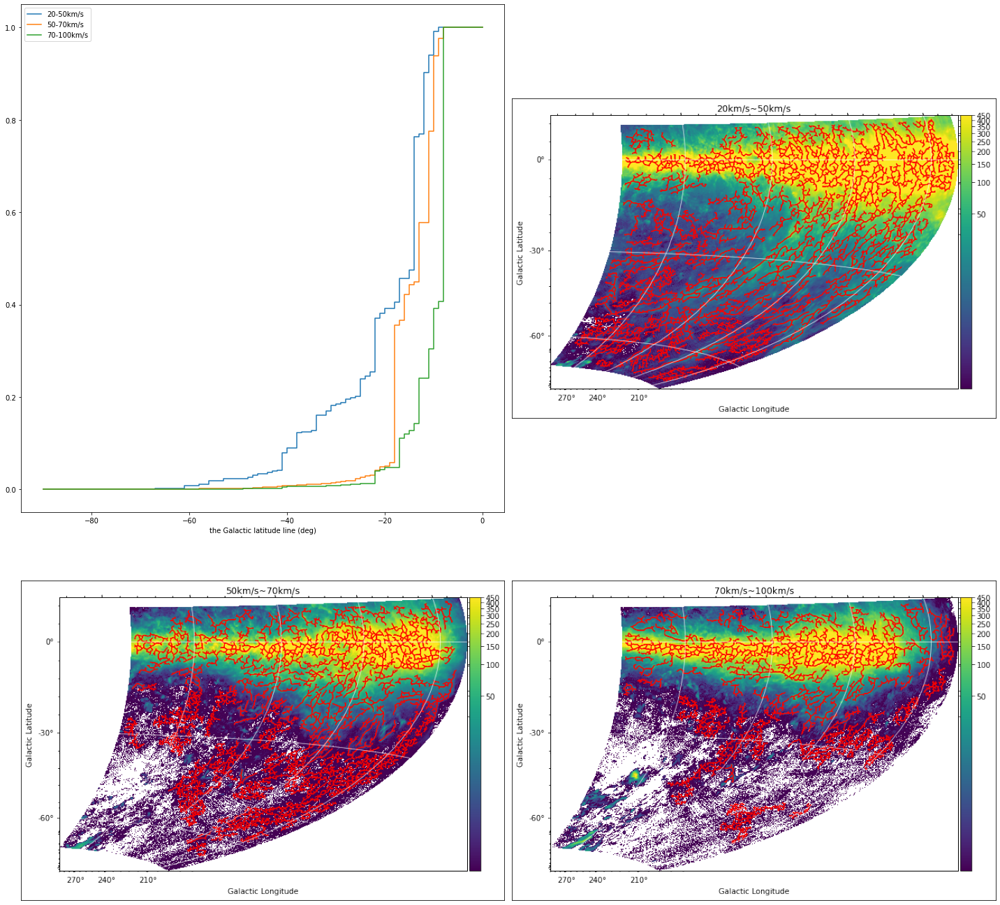

In [23]:
a = plt.imread("/home/filament/Downloads/fil_remake/test_2_20_50.png")
b = plt.imread("/home/filament/Downloads/fil_remake/test_2_50_70.png")
c = plt.imread("/home/filament/Downloads/fil_remake/test_2_70_100.png")
fig = plt.figure(figsize=(20,20))
ax1 = plt.subplot(2,2,2)
ax2 = plt.subplot(2,2,3)
ax3 = plt.subplot(2,2,4)

ax0 = plt.subplot(2,2,1)


ax0.step(range(-90,1),ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "20-50km/s")
ax0.step(range(-90,1),ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "50-70km/s")
ax0.step(range(-90,1),ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "70-100km/s")
ax0.set_xlabel("the Galactic latitude line (deg)")
ax0.set_ylabel("")
ax0.legend()



ax1.imshow(a)
ax2.imshow(b)
ax3.imshow(c)
ax1.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax2.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax3.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)

plt.tight_layout()

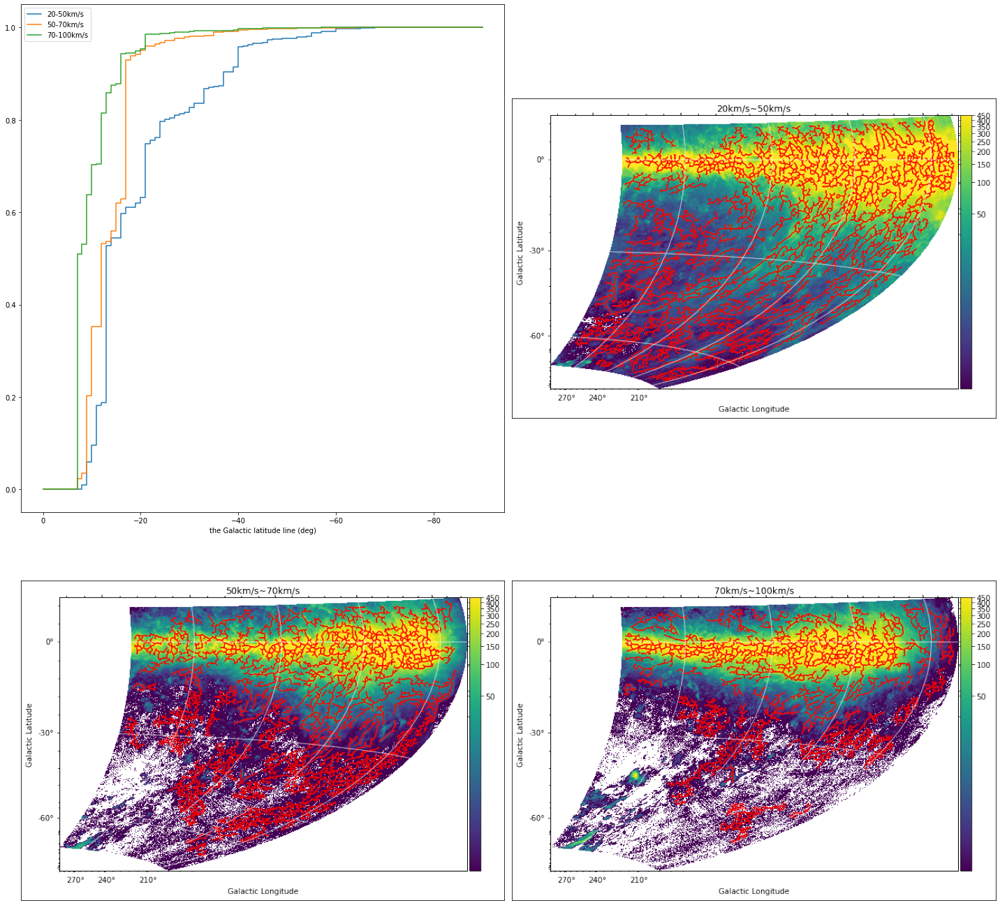

In [19]:
a = plt.imread("/home/filament/Downloads/fil_remake/test_2_20_50.png")
b = plt.imread("/home/filament/Downloads/fil_remake/test_2_50_70.png")
c = plt.imread("/home/filament/Downloads/fil_remake/test_2_70_100.png")
fig = plt.figure(figsize=(20,20))
ax1 = plt.subplot(2,2,2)
ax2 = plt.subplot(2,2,3)
ax3 = plt.subplot(2,2,4)

ax0 = plt.subplot(2,2,1)


ax0.step(b_ls,ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "20-50km/s")
ax0.step(b_ls,ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "50-70km/s")
ax0.step(b_ls,ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "70-100km/s")

ax0.invert_xaxis()


ax0.set_xlabel("the Galactic latitude line (deg)")
ax0.set_ylabel("")
ax0.legend()



ax1.imshow(a)
ax2.imshow(b)
ax3.imshow(c)
ax1.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax2.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax3.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)

plt.tight_layout()

region3

In [31]:
fits_pwd = "/home/filament/Desktop/fil-test/fil_finder_fits/test_3.fits"
hdu = fits.open(fits_pwd)[0]
w = WCS(fits_pwd)

#arr = np.nanmax(hdu.data[:, :256, :256], axis=0).astype(">f4")
# arr = hdu.data[468, :256, :256].astype(">f4")
fits_pwd.split('/')[6].split('.')[0]

'test_3'

In [32]:
hdu.header["CUNIT1"] = "deg"
hdu.header["CUNIT2"] = "deg"
hdu.header["BPA"] = 0.0
hdu.header["BMAJ"] = 0.2706
hdu.header["BMIN"] = 0.2706
hdu.header["LONPOLE"] = 0.0
hdu.header["LATPOLE"] = 90.0

In [33]:
##########
integ_hdu = make_new_hdu_integ(hdu, 20.0, 50.0, w)
##########

In [34]:
hdr1 = fits.PrimaryHDU().header
hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
# hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
# hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
hdr1["CDELT1"] = -0.01
hdr1["CDELT2"] = 0.01
hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
hdr1["BPA"] = integ_hdu.header["BPA"]
hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
hdr1["BMIN"] = integ_hdu.header["BMIN"]
hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]


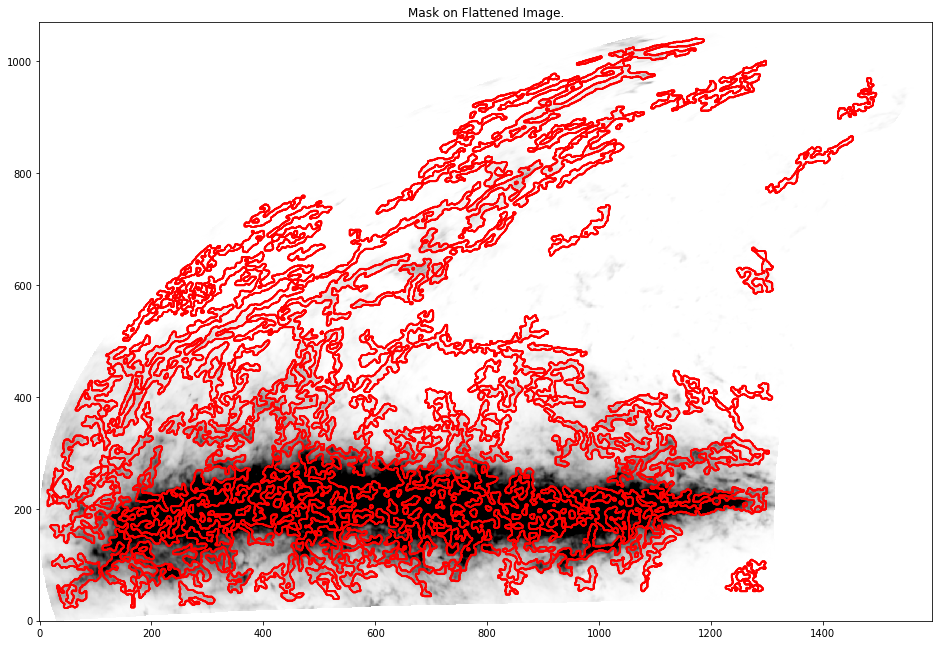

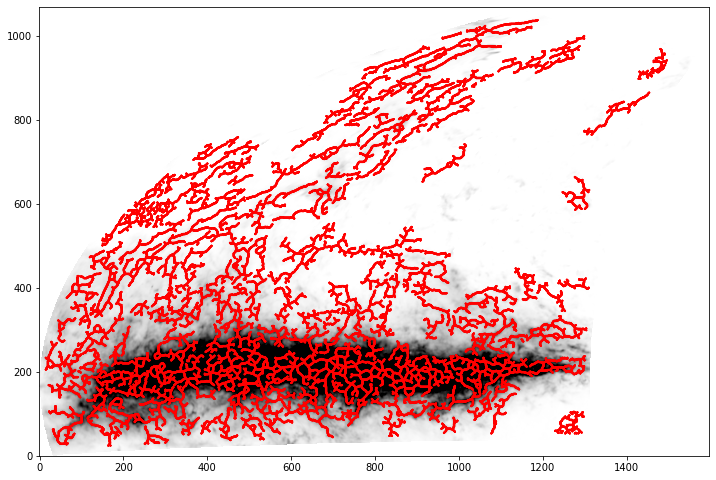

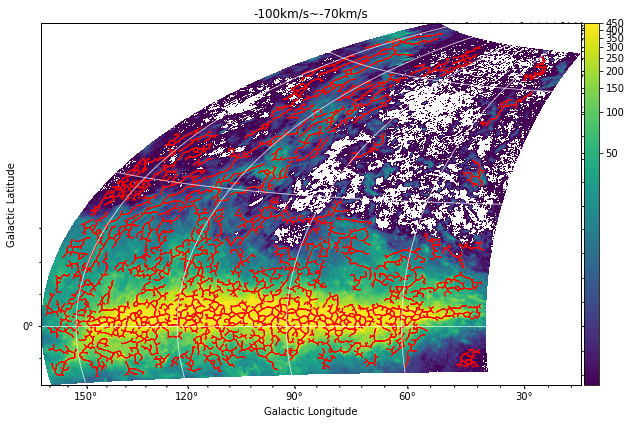

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"


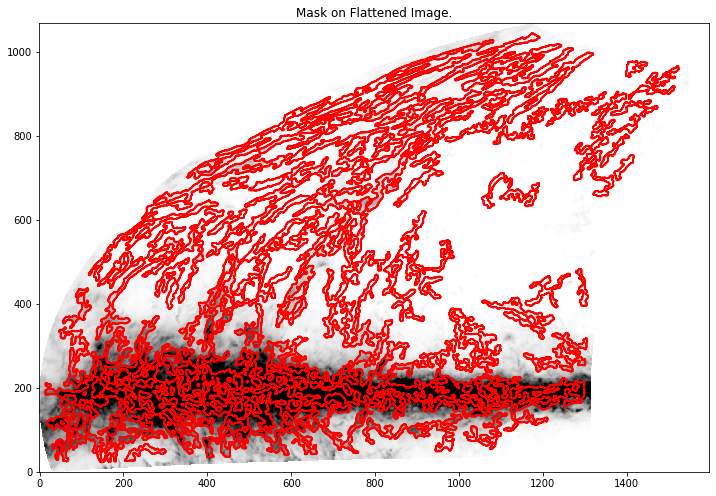

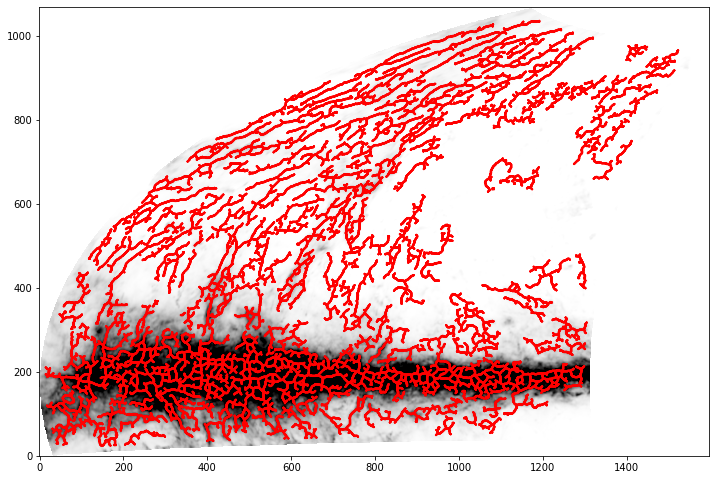

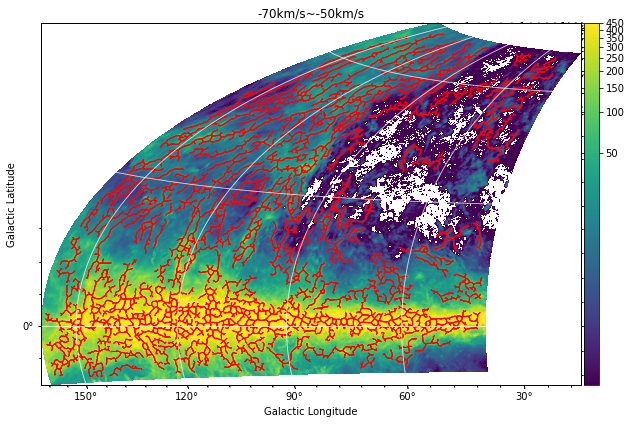

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


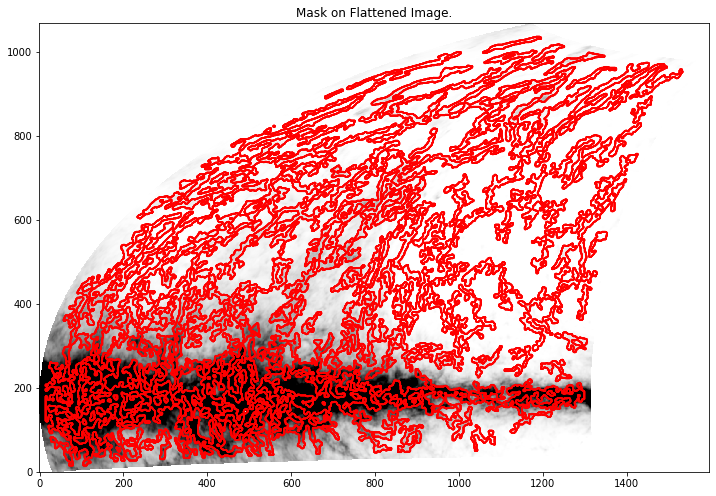

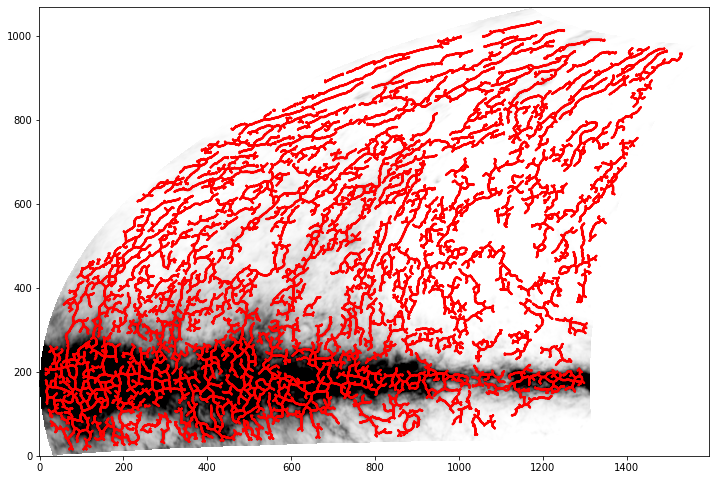

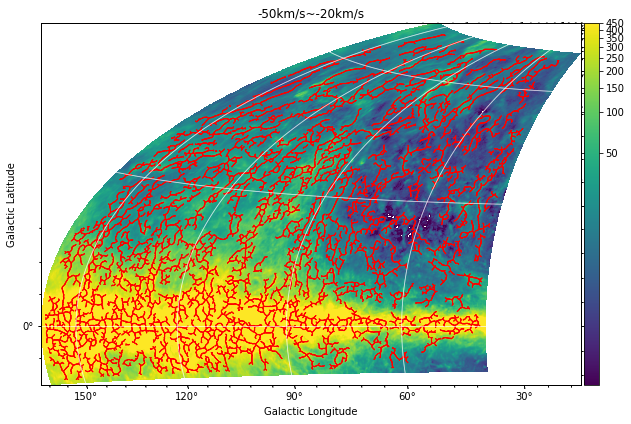

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:894: RuntimeWarning: invalid value encountered in sqrt
  fit_uncert = list(np.sqrt(np.diag(param_cov)))


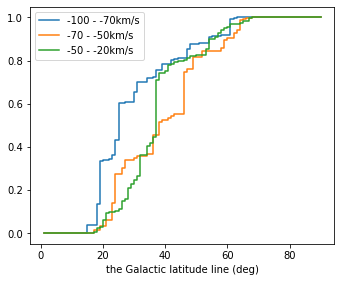

In [35]:
ls = [[-100,-70],[-70,-50],[-50,-20]]
ruiseki_ls = []
fil_to_b = []

fig_ls = []

fig = plt.figure(figsize=(16,16))
for i,j in enumerate(ls):
    
    w = WCS(hdu)


    v_start,v_end,d,bmaj,cdelt,vmin,vmax = j[0],j[1],10,0.2706,0.083333333,1,450
    ##########################
    #     wcs = WCS(hdu.header)
    ##########################


    integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
    integ_hdu.data[integ_hdu.data<=0.01]=np.nan  ####0.01
    hdr1 = fits.PrimaryHDU().header
    hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
    hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
    hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
    hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
    # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
    # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
    hdr1["CDELT1"] = -cdelt
    hdr1["CDELT2"] = cdelt
    hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
    hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
    hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
    hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
    hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
    hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
    hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
    hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
    #     hdr1["BPA"] = integ_hdu.header["BPA"]
    #     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
    #     hdr1["BMIN"] = integ_hdu.header["BMIN"]
    #     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
    #     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



    fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

    fil.preprocess_image(flatten_percent=95)
    fil.create_mask(verbose=True)
    fil.medskel(verbose=True)
    fil_skeleton= fil.skeleton
    fil_skeleton = fil_skeleton.astype("int")
    hdr2 = copy.deepcopy(hdu.header)
    hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    hdr2["NAXIS"]=2
    hdr2["WCSAXES"]=2

#     fig_ = aplpy.FITSFigure(integ_hdu,slices=[0],figure=fig,subplot=(2,2,i+2))
    fig_ = aplpy.FITSFigure(integ_hdu,slices=[0])
    fig_.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
    fig_.add_colorbar()
    fig_.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
    fig_.add_grid()
    fig_.set_title("%ikm/s~%ikm/s"%(v_start,v_end))
    fig_.savefig("/home/filament/Downloads/fil_remake/%s_%i_%i.png"%(fits_pwd.split('/')[6].split('.')[0],v_start,v_end))
    integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)
    fig_ls.append(fig_)
    plt.show()


#     plt.clf()

    fil.analyze_skeletons()
    fil.exec_rht()
    fil.find_widths(max_dist=10 * u.pix)
    total_intensity_arr = fil.total_intensity()

    ypos = np.array([f.position()[0].value for f in fil.filaments])
    
    
    ruiseki = []
    for k in range(1,91):
        c = 0.0
        for j,f in enumerate(fil.filaments):
            if f.position()[0].value<400:
                continue
            pos = w.wcs_pix2world(f.position()[1],f.position()[0],0,0)
            
            if pos[1] < k:
                
                c += total_intensity_arr[j]
        ruiseki.append(c)
    ruiseki_ls.append(ruiseki)
#             pos = w.wcs_pix2world(i.position()[1],i.position()[0],0,0)   #return:(l,b)


#             coo_ls.append(pos)
#             b_ls.append(pos[1])

ax1 = plt.subplot(2,2,1)


ax1.step(range(1,91),ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "-100 - -70km/s")
ax1.step(range(1,91),ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "-70 - -50km/s")
ax1.step(range(1,91),ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "-50 - -20km/s")
ax1.set_xlabel("the Galactic latitude line (deg)")
ax1.set_ylabel("")
ax1.legend()  
        
plt.show()
    
#     coo_ls = []
#     b_ls = []
#     for i in fil.filaments:
#         if j.position()[0].value<400:
#             continue
#         pos = w.wcs_pix2world(j.position()[1],j.position()[0],0,0)   #return:(l,b)

#         coo_ls.append(pos)
#         b_ls.append(pos[1])
        
        
#     b_ls_ = []
#     for i in b_ls:
#         b_ls_.append(i)
    
#     b_ls_array = np.array(b_ls_)
    
#     fil_to_b.append(b_ls_array)
    
    


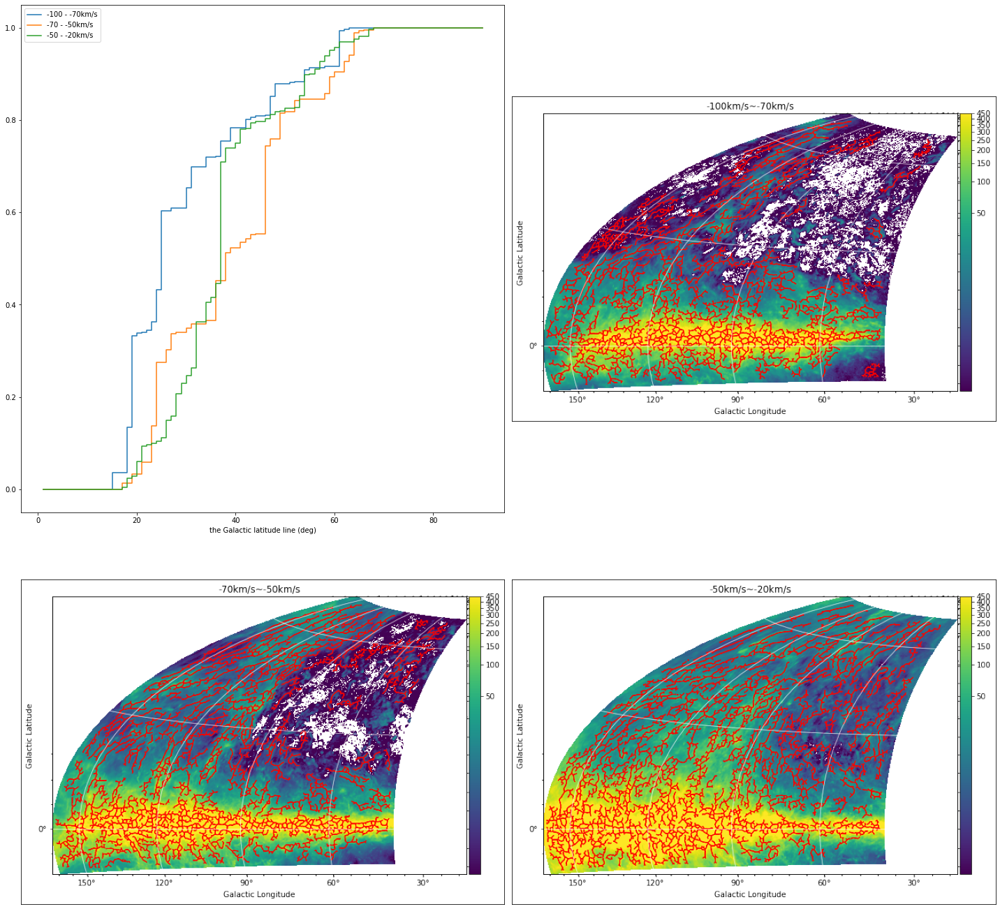

In [36]:
a = plt.imread("/home/filament/Downloads/fil_remake/test_3_-100_-70.png")
b = plt.imread("/home/filament/Downloads/fil_remake/test_3_-70_-50.png")
c = plt.imread("/home/filament/Downloads/fil_remake/test_3_-50_-20.png")
fig = plt.figure(figsize=(20,20))
ax1 = plt.subplot(2,2,2)
ax2 = plt.subplot(2,2,3)
ax3 = plt.subplot(2,2,4)

ax0 = plt.subplot(2,2,1)


ax0.step(range(1,91),ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "-100 - -70km/s")
ax0.step(range(1,91),ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "-70 - -50km/s")
ax0.step(range(1,91),ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "-50 - -20km/s")
ax0.set_xlabel("the Galactic latitude line (deg)")
ax0.set_ylabel("")
ax0.legend()



ax1.imshow(a)
ax2.imshow(b)
ax3.imshow(c)
ax1.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax2.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax3.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)

plt.tight_layout()

region4

In [47]:
fits_pwd = "/home/filament/Desktop/fil-test/fil_finder_fits/test_4.fits"
hdu = fits.open(fits_pwd)[0]
w = WCS(fits_pwd)

#arr = np.nanmax(hdu.data[:, :256, :256], axis=0).astype(">f4")
# arr = hdu.data[468, :256, :256].astype(">f4")


In [48]:
fits_pwd.split('/')[6].split('.')[0]

'test_4'

In [49]:
hdu.header["CUNIT1"] = "deg"
hdu.header["CUNIT2"] = "deg"
hdu.header["BPA"] = 0.0
hdu.header["BMAJ"] = 0.2706
hdu.header["BMIN"] = 0.2706
hdu.header["LONPOLE"] = 0.0
hdu.header["LATPOLE"] = 90.0

In [27]:
##########
integ_hdu = make_new_hdu_integ(hdu, 20.0, 50.0, w)
##########

In [28]:
hdr1 = fits.PrimaryHDU().header
hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
# hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
# hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
hdr1["CDELT1"] = -0.01
hdr1["CDELT2"] = 0.01
hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
hdr1["BPA"] = integ_hdu.header["BPA"]
hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
hdr1["BMIN"] = integ_hdu.header["BMIN"]
hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]


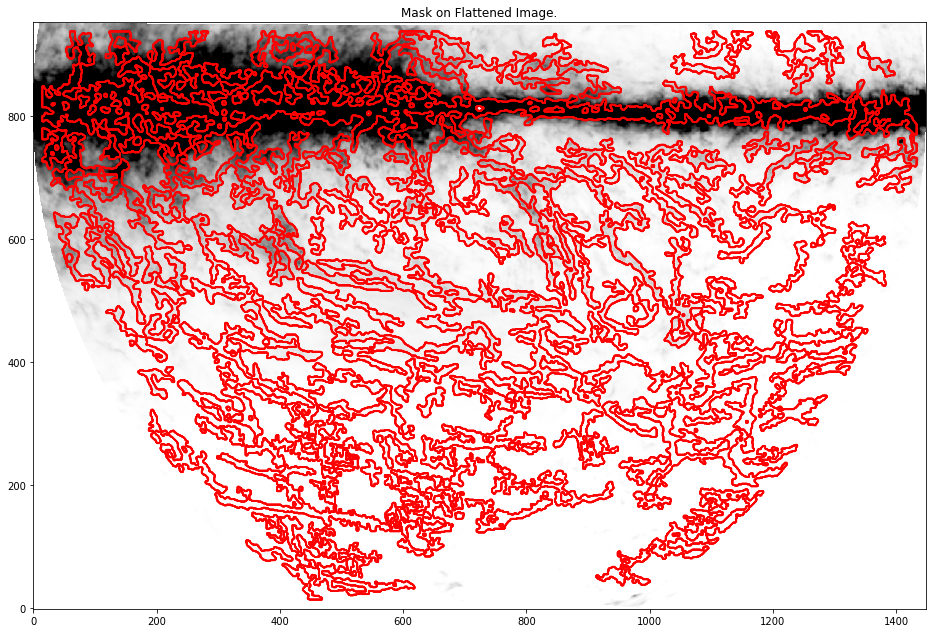

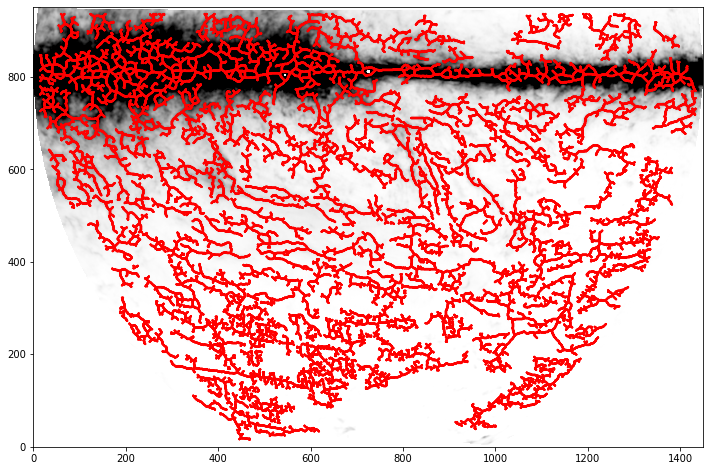

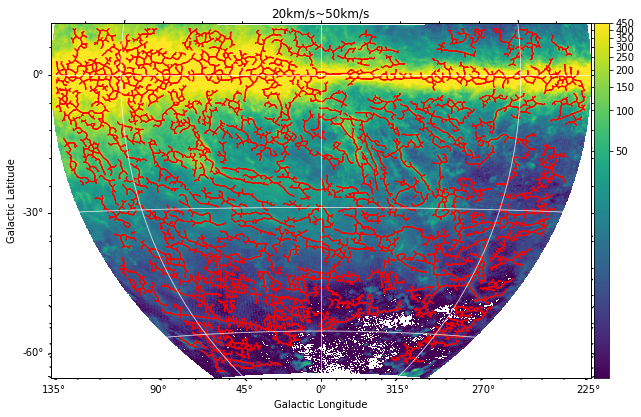

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"


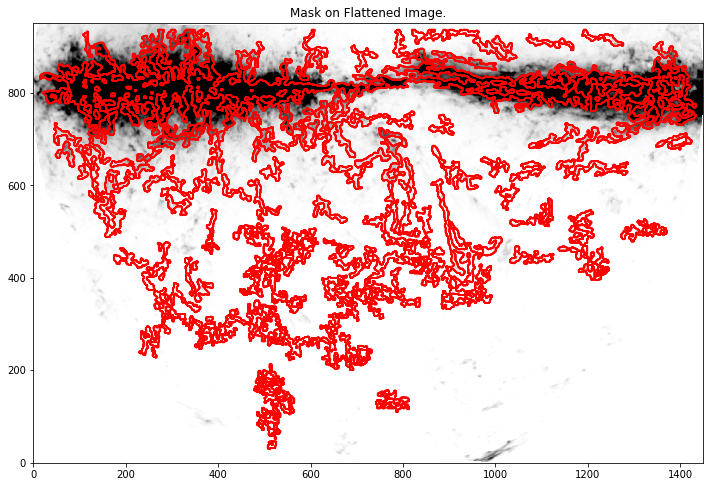

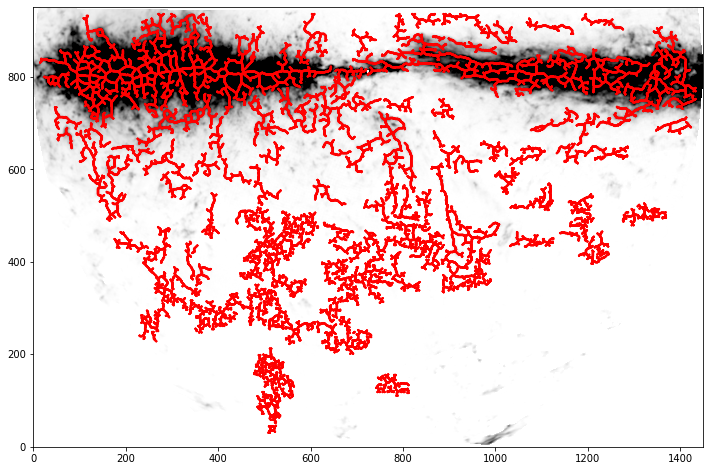

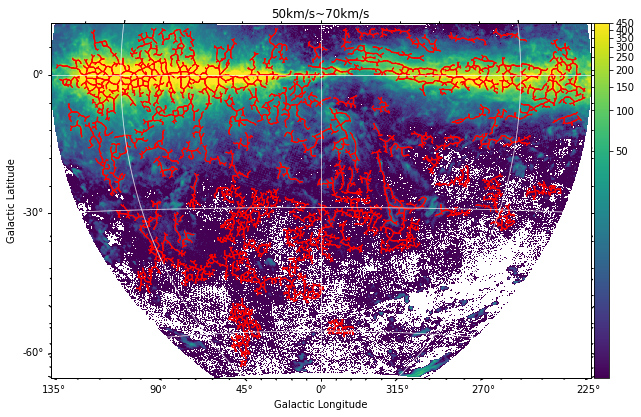

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/sit

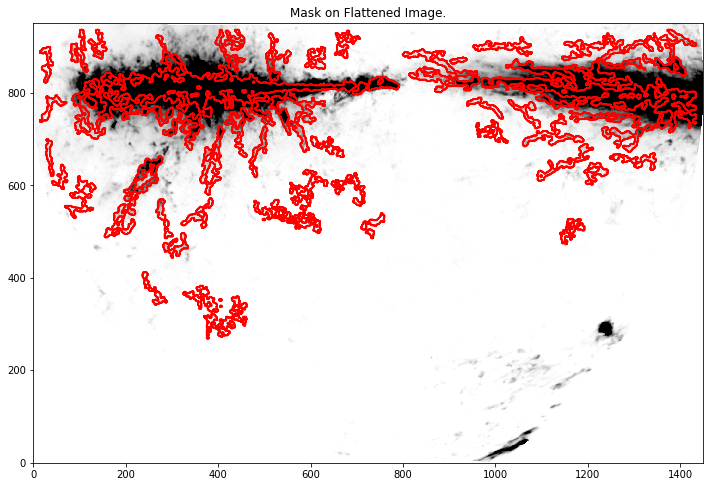

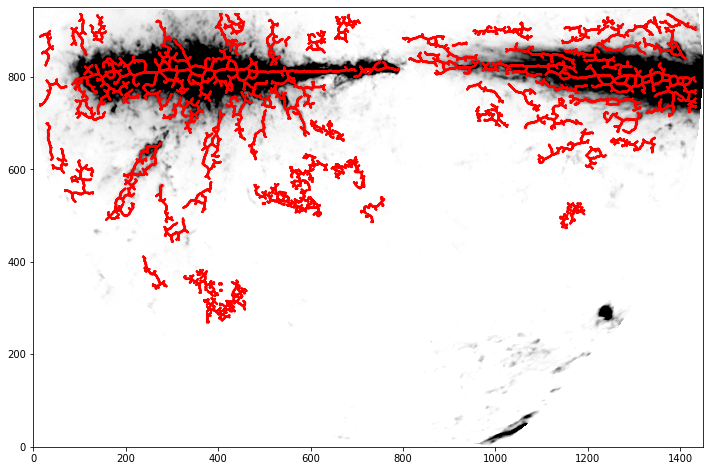

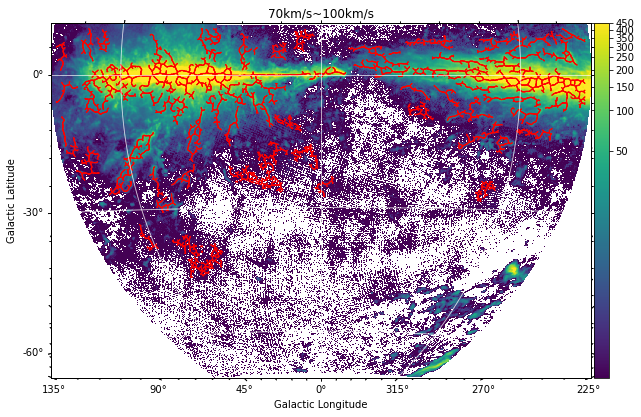

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


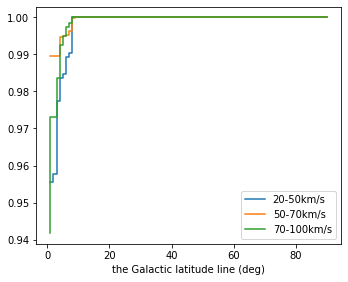

In [42]:
ls = [[20,50],[50,70],[70,100]]
ruiseki_ls = []
fil_to_b = []

fig_ls = []

fig = plt.figure(figsize=(16,16))
for i,j in enumerate(ls):
    
    w = WCS(hdu)


    v_start,v_end,d,bmaj,cdelt,vmin,vmax = j[0],j[1],10,0.2706,0.083333333,1,450
    ##########################
    #     wcs = WCS(hdu.header)
    ##########################


    integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
    integ_hdu.data[integ_hdu.data<=0.01]=np.nan  ####0.01
    hdr1 = fits.PrimaryHDU().header
    hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
    hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
    hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
    hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
    # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
    # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
    hdr1["CDELT1"] = -cdelt
    hdr1["CDELT2"] = cdelt
    hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
    hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
    hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
    hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
    hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
    hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
    hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
    hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
    #     hdr1["BPA"] = integ_hdu.header["BPA"]
    #     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
    #     hdr1["BMIN"] = integ_hdu.header["BMIN"]
    #     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
    #     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



    fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

    fil.preprocess_image(flatten_percent=95)
    fil.create_mask(verbose=True)
    fil.medskel(verbose=True)
    fil_skeleton= fil.skeleton
    fil_skeleton = fil_skeleton.astype("int")
    hdr2 = copy.deepcopy(hdu.header)
    hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    hdr2["NAXIS"]=2
    hdr2["WCSAXES"]=2

#     fig_ = aplpy.FITSFigure(integ_hdu,slices=[0],figure=fig,subplot=(2,2,i+2))
    fig_ = aplpy.FITSFigure(integ_hdu,slices=[0])
    fig_.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
    fig_.add_colorbar()
    fig_.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
    fig_.add_grid()
    fig_.set_title("%ikm/s~%ikm/s"%(v_start,v_end))
    fig_.savefig("/home/filament/Downloads/fil_remake/%s_%i_%i.png"%(fits_pwd.split('/')[6].split('.')[0],v_start,v_end))
    integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)
    fig_ls.append(fig_)
    plt.show()


#     plt.clf()

    fil.analyze_skeletons()
    fil.exec_rht()
    fil.find_widths(max_dist=10 * u.pix)
    total_intensity_arr = fil.total_intensity()

    ypos = np.array([f.position()[0].value for f in fil.filaments])
    
    
    ruiseki = []
    for k in range(-91,1):
        c = 0.0
        for j,f in enumerate(fil.filaments):
            if f.position()[0].value<400:
                continue
            pos = w.wcs_pix2world(f.position()[1],f.position()[0],0,0)
            
            if pos[1] < k:
                
                c += total_intensity_arr[j]
        ruiseki.append(c)
    ruiseki_ls.append(ruiseki)
#             pos = w.wcs_pix2world(i.position()[1],i.position()[0],0,0)   #return:(l,b)


#             coo_ls.append(pos)
#             b_ls.append(pos[1])

ax1 = plt.subplot(2,2,1)


ax1.step(range(1,91),ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "20-50km/s")
ax1.step(range(1,91),ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "50-70km/s")
ax1.step(range(1,91),ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "70-100km/s")
ax1.set_xlabel("the Galactic latitude line (deg)")
ax1.set_ylabel("")
ax1.legend()  
        
plt.show()
    
#     coo_ls = []
#     b_ls = []
#     for i in fil.filaments:
#         if j.position()[0].value<400:
#             continue
#         pos = w.wcs_pix2world(j.position()[1],j.position()[0],0,0)   #return:(l,b)

#         coo_ls.append(pos)
#         b_ls.append(pos[1])
        
        
#     b_ls_ = []
#     for i in b_ls:
#         b_ls_.append(i)
    
#     b_ls_array = np.array(b_ls_)
    
#     fil_to_b.append(b_ls_array)
    
    


In [46]:
fig_ls[0]
plt.show()

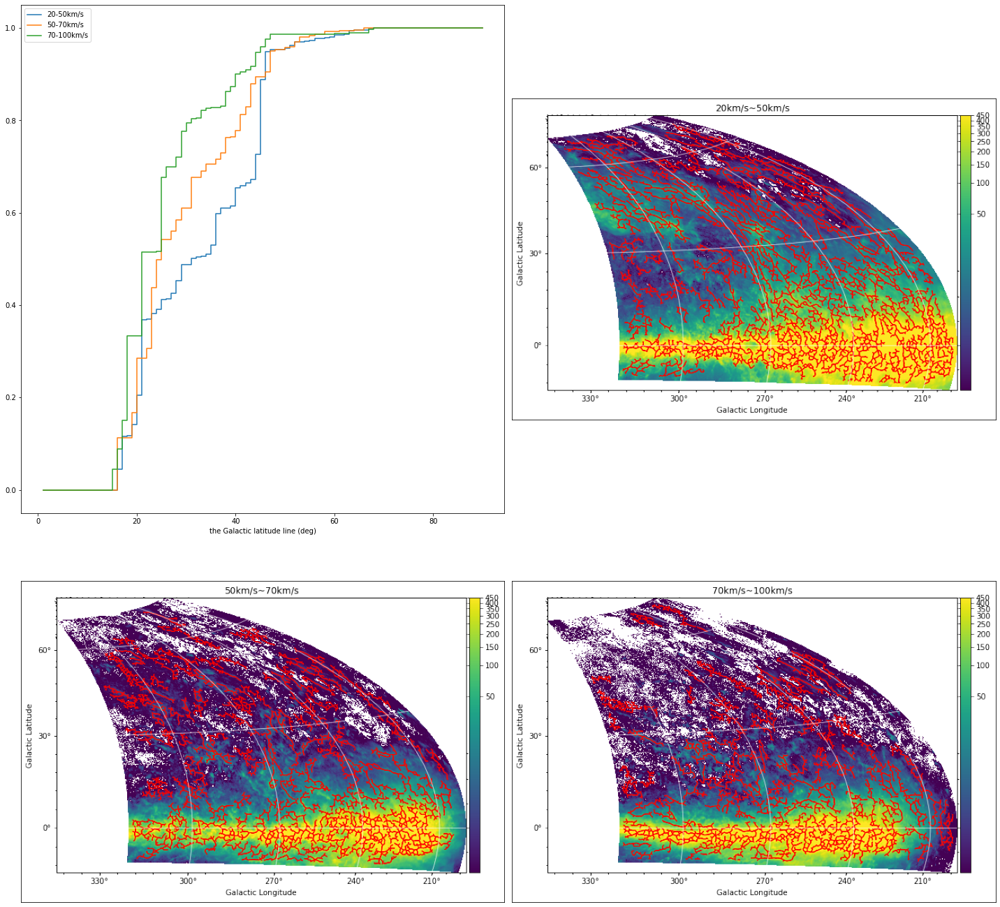

In [30]:
a = plt.imread("/home/filament/Downloads/fil_remake/test_4_20_50.png")
b = plt.imread("/home/filament/Downloads/fil_remake/test_4_50_70.png")
c = plt.imread("/home/filament/Downloads/fil_remake/test_4_70_100.png")
fig = plt.figure(figsize=(20,20))
ax1 = plt.subplot(2,2,2)
ax2 = plt.subplot(2,2,3)
ax3 = plt.subplot(2,2,4)

ax0 = plt.subplot(2,2,1)


ax0.step(range(1,91),ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "20-50km/s")
ax0.step(range(1,91),ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "50-70km/s")
ax0.step(range(1,91),ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "70-100km/s")
ax0.set_xlabel("the Galactic latitude line (deg)")
ax0.set_ylabel("")
ax0.legend()



ax1.imshow(a)
ax2.imshow(b)
ax3.imshow(c)
ax1.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax2.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax3.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)

plt.tight_layout()

region5

In [94]:
fits_pwd = "/home/filament/Desktop/fil-test/fil_finder_fits/test_5.fits"
hdu = fits.open(fits_pwd)[0]
w = WCS(fits_pwd)

#arr = np.nanmax(hdu.data[:, :256, :256], axis=0).astype(">f4")
# arr = hdu.data[468, :256, :256].astype(">f4")


In [95]:
hdu.header["CUNIT1"] = "deg"
hdu.header["CUNIT2"] = "deg"
hdu.header["BPA"] = 0.0
hdu.header["BMAJ"] = 0.2706
hdu.header["BMIN"] = 0.2706
hdu.header["LONPOLE"] = 0.0
hdu.header["LATPOLE"] = 90.0

In [96]:
##########
integ_hdu = make_new_hdu_integ(hdu, 20.0, 50.0, w)
##########

In [97]:
hdr1 = fits.PrimaryHDU().header
hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
# hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
# hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
hdr1["CDELT1"] = -0.01
hdr1["CDELT2"] = 0.01
hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
hdr1["BPA"] = integ_hdu.header["BPA"]
hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
hdr1["BMIN"] = integ_hdu.header["BMIN"]
hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]


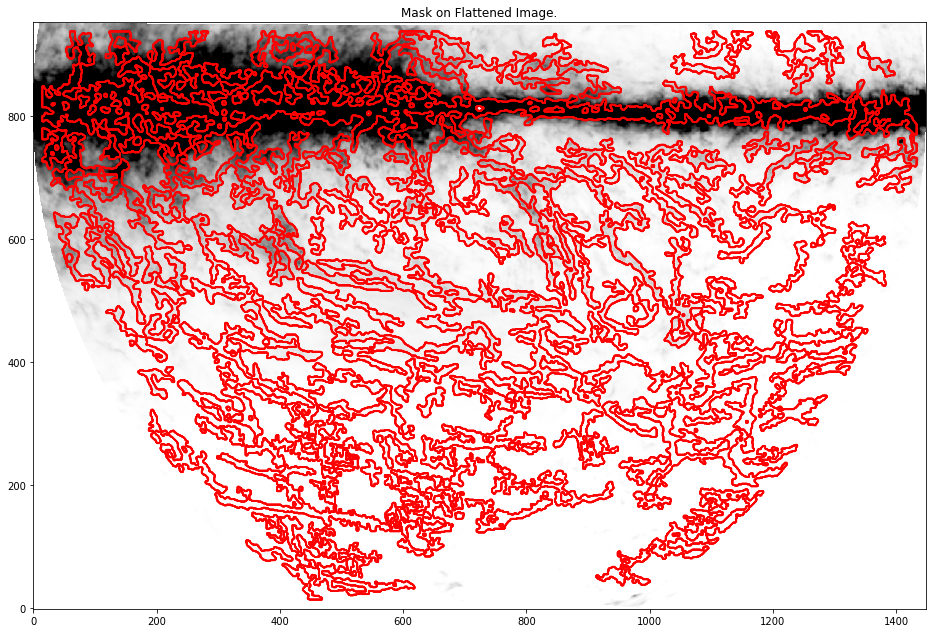

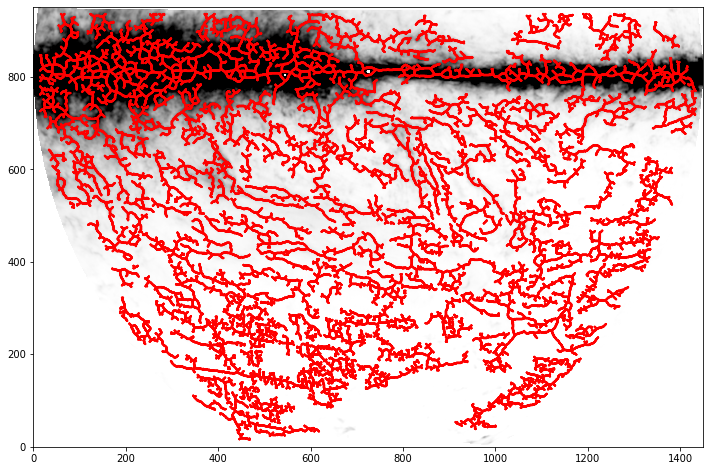

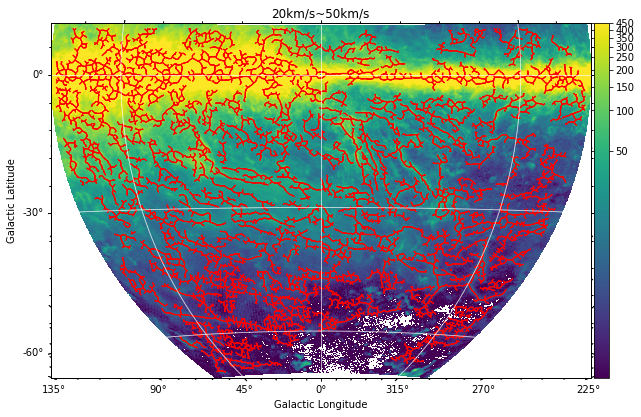

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


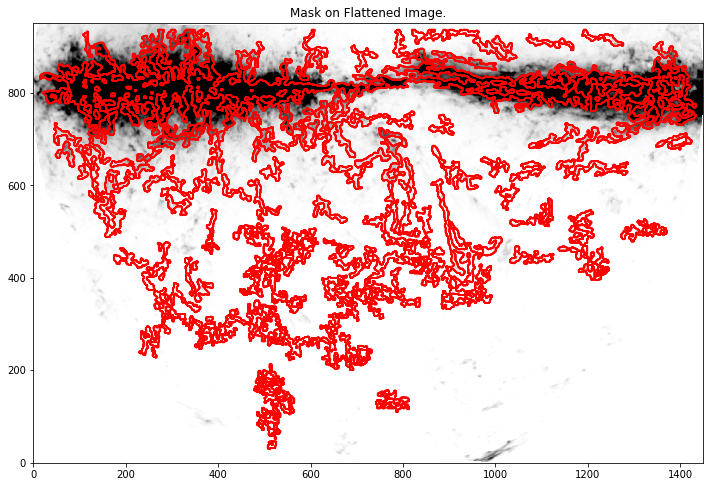

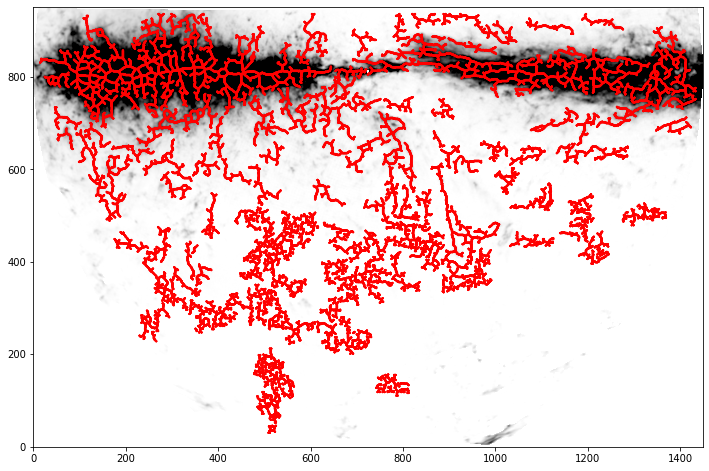

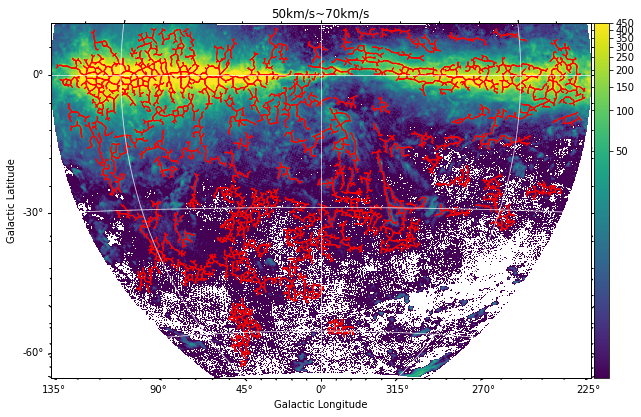

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


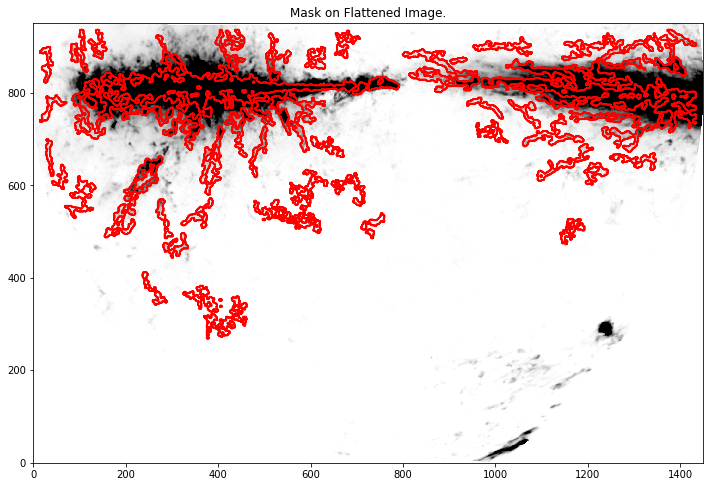

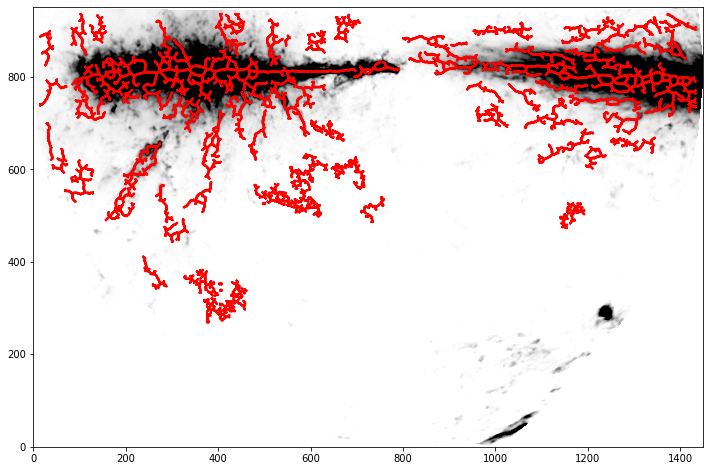

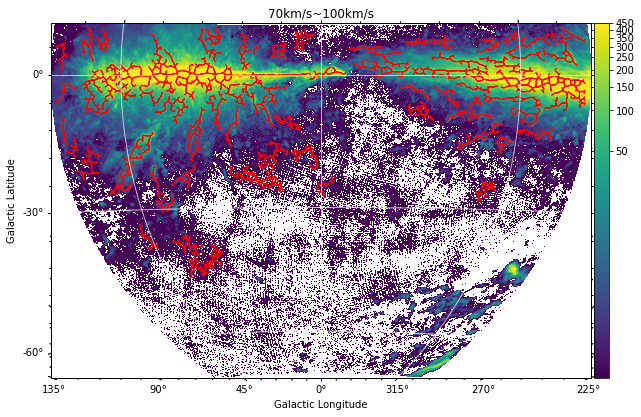

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


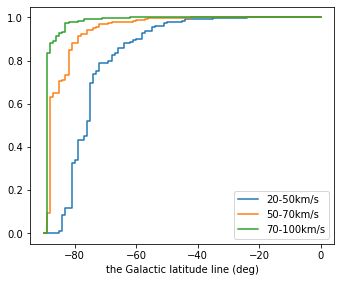

In [99]:
ls = [[20,50],[50,70],[70,100]]
ruiseki_ls = []
fil_to_b = []

fig_ls = []

b_ls = []

for i in range(-90,1):
        b_ls.append(i)
b_ls = b_ls[::-1]

fig = plt.figure(figsize=(16,16))
for i,j in enumerate(ls):
    
    w = WCS(hdu)


    v_start,v_end,d,bmaj,cdelt,vmin,vmax = j[0],j[1],10,0.2706,0.083333333,1,450
    ##########################
    #     wcs = WCS(hdu.header)
    ##########################


    integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
    integ_hdu.data[integ_hdu.data<=0.01]=np.nan  ####0.01
    hdr1 = fits.PrimaryHDU().header
    hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
    hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
    hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
    hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
    # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
    # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
    hdr1["CDELT1"] = -cdelt
    hdr1["CDELT2"] = cdelt
    hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
    hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
    hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
    hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
    hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
    hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
    hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
    hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
    #     hdr1["BPA"] = integ_hdu.header["BPA"]
    #     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
    #     hdr1["BMIN"] = integ_hdu.header["BMIN"]
    #     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
    #     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



    fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

    fil.preprocess_image(flatten_percent=95)
    fil.create_mask(verbose=True)
    fil.medskel(verbose=True)
    fil_skeleton= fil.skeleton
    fil_skeleton = fil_skeleton.astype("int")
    hdr2 = copy.deepcopy(hdu.header)
    hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    hdr2["NAXIS"]=2
    hdr2["WCSAXES"]=2

#     fig_ = aplpy.FITSFigure(integ_hdu,slices=[0],figure=fig,subplot=(2,2,i+2))
    fig_ = aplpy.FITSFigure(integ_hdu,slices=[0])
    fig_.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
    fig_.add_colorbar()
    fig_.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
    fig_.add_grid()
    fig_.set_title("%ikm/s~%ikm/s"%(v_start,v_end))
    fig_.savefig("/home/filament/Downloads/fil_remake/%s_%i_%i.png"%(fits_pwd.split('/')[6].split('.')[0],v_start,v_end))
    integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)
    fig_ls.append(fig_)
    plt.show()


#     plt.clf()

    fil.analyze_skeletons()
    fil.exec_rht()
    fil.find_widths(max_dist=10 * u.pix)
    total_intensity_arr = fil.total_intensity()

    ypos = np.array([f.position()[0].value for f in fil.filaments])
    
    
    ruiseki = []
    

        
    for k in b_ls:
        c = 0.0
        for j,f in enumerate(fil.filaments):
            if f.position()[0].value>800:
                continue
            pos = w.wcs_pix2world(f.position()[1],f.position()[0],0,0)
            
            if pos[1] > k:
                
                c += total_intensity_arr[j]
        ruiseki.append(c)
    ruiseki_ls.append(ruiseki)
#             pos = w.wcs_pix2world(i.position()[1],i.position()[0],0,0)   #return:(l,b)


#             coo_ls.append(pos)
#             b_ls.append(pos[1])

ax1 = plt.subplot(2,2,1)


ax1.step(range(-90,1),ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "20-50km/s")
ax1.step(range(-90,1),ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "50-70km/s")
ax1.step(range(-90,1),ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "70-100km/s")


ax1.set_xlabel("the Galactic latitude line (deg)")
ax1.set_ylabel("")
ax1.legend()  
        
plt.show()
    
#     coo_ls = []
#     b_ls = []
#     for i in fil.filaments:
#         if j.position()[0].value<400:
#             continue
#         pos = w.wcs_pix2world(j.position()[1],j.position()[0],0,0)   #return:(l,b)

#         coo_ls.append(pos)
#         b_ls.append(pos[1])
        
        
#     b_ls_ = []
#     for i in b_ls:
#         b_ls_.append(i)
    
#     b_ls_array = np.array(b_ls_)
    
#     fil_to_b.append(b_ls_array)
    
    


In [109]:
a = reversed(range(-90,1))
a

<Figure size 864x691.2 with 0 Axes>

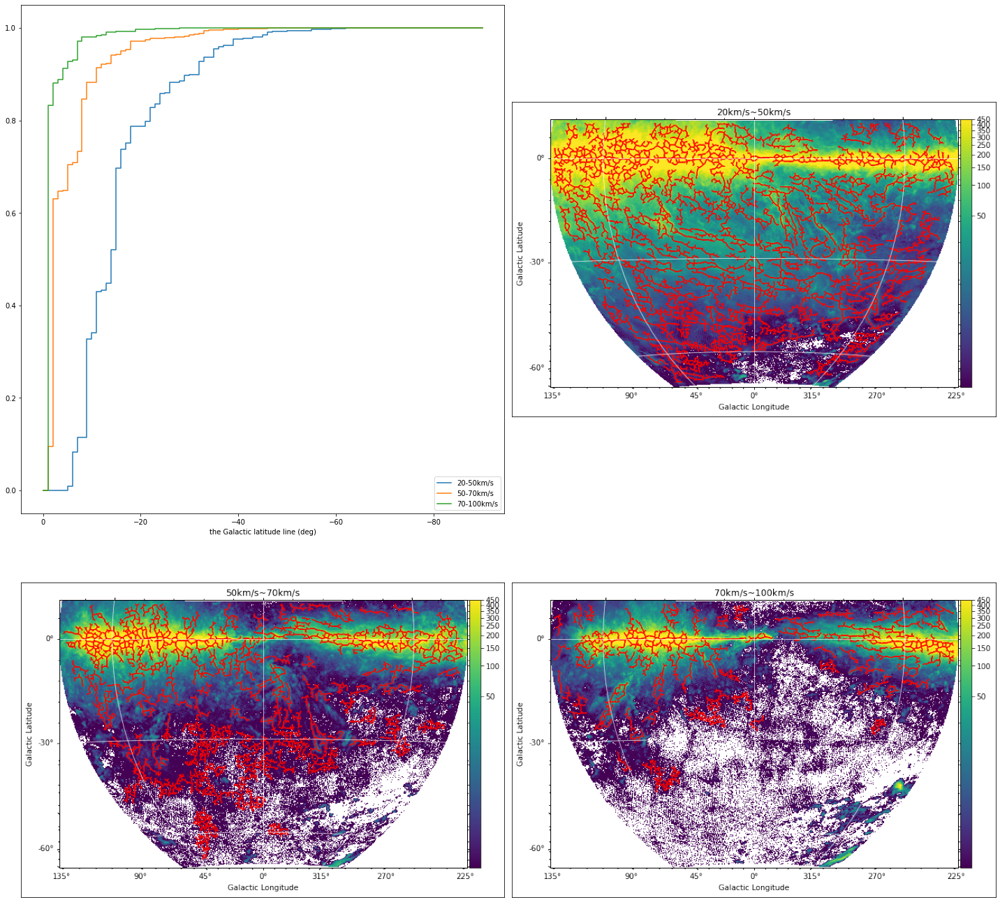

In [122]:
plt.clf()
a = plt.imread("/home/filament/Downloads/fil_remake/test_5_20_50.png")
b = plt.imread("/home/filament/Downloads/fil_remake/test_5_50_70.png")
c = plt.imread("/home/filament/Downloads/fil_remake/test_5_70_100.png")
fig = plt.figure(figsize=(20,20))
ax1 = plt.subplot(2,2,2)
ax2 = plt.subplot(2,2,3)
ax3 = plt.subplot(2,2,4)

ax0 = plt.subplot(2,2,1)


ax0.step(b_ls,ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "20-50km/s")

ax0.step(b_ls,ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "50-70km/s")

ax0.step(b_ls,ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "70-100km/s")

ax0.invert_xaxis()


ax0.set_xlabel("the Galactic latitude line (deg)")
ax0.set_ylabel("")
ax0.legend()



ax1.imshow(a)
ax2.imshow(b)
ax3.imshow(c)
ax1.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax2.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax3.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)

plt.tight_layout()

region6

In [58]:
fits_pwd = "/home/filament/Desktop/fil-test/fil_finder_fits/test_6.fits"
hdu = fits.open(fits_pwd)[0]
w = WCS(fits_pwd)

#arr = np.nanmax(hdu.data[:, :256, :256], axis=0).astype(">f4")
# arr = hdu.data[468, :256, :256].astype(">f4")


In [59]:
hdu.header["CUNIT1"] = "deg"
hdu.header["CUNIT2"] = "deg"
hdu.header["BPA"] = 0.0
hdu.header["BMAJ"] = 0.2706
hdu.header["BMIN"] = 0.2706
hdu.header["LONPOLE"] = 0.0
hdu.header["LATPOLE"] = 90.0

In [60]:
##########
integ_hdu = make_new_hdu_integ(hdu, 20.0, 50.0, w)
##########

In [61]:
hdr1 = fits.PrimaryHDU().header
hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
# hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
# hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
hdr1["CDELT1"] = -0.01
hdr1["CDELT2"] = 0.01
hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
hdr1["BPA"] = integ_hdu.header["BPA"]
hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
hdr1["BMIN"] = integ_hdu.header["BMIN"]
hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]


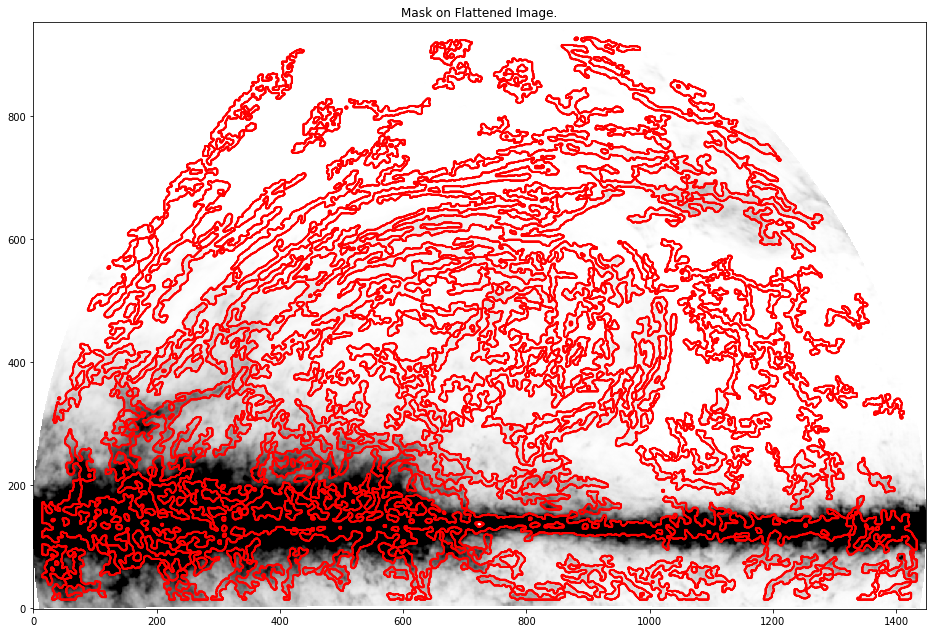

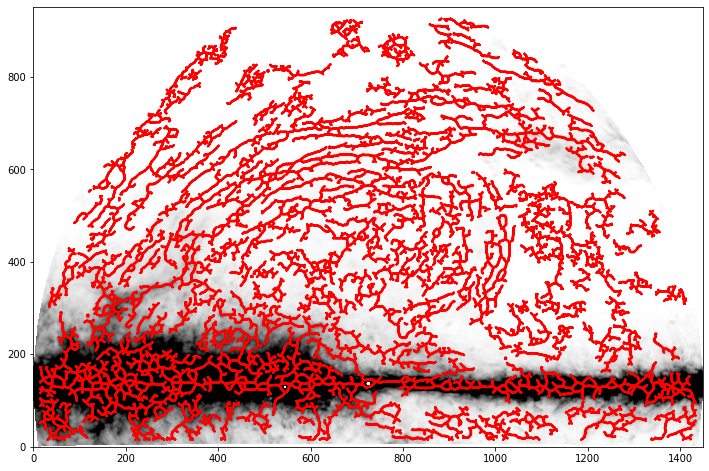

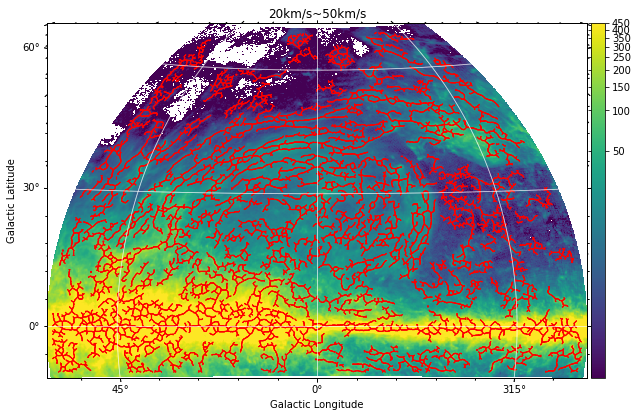

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


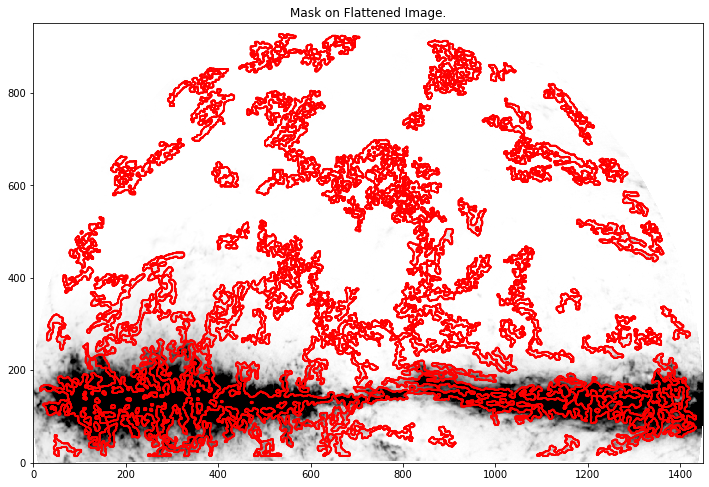

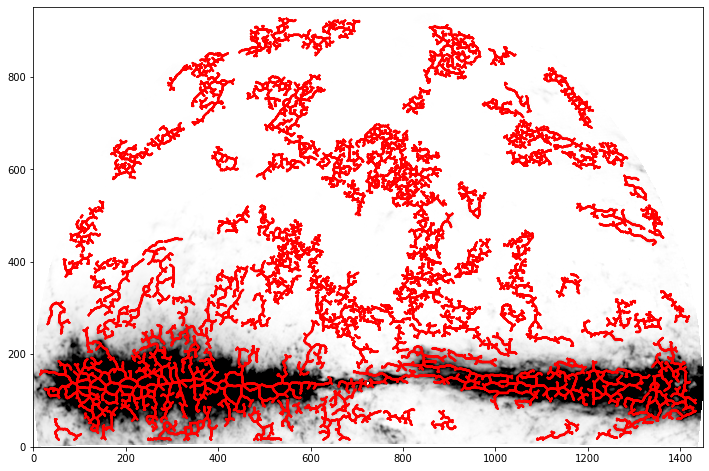

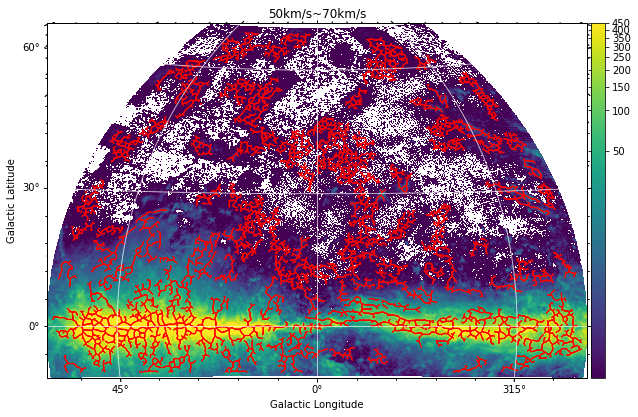

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


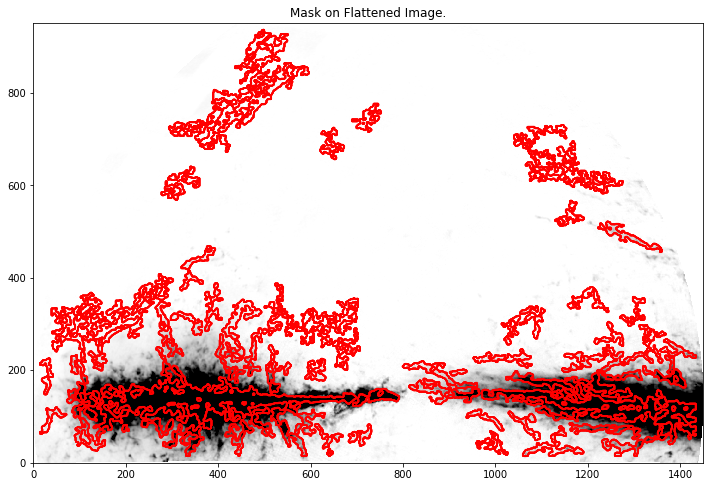

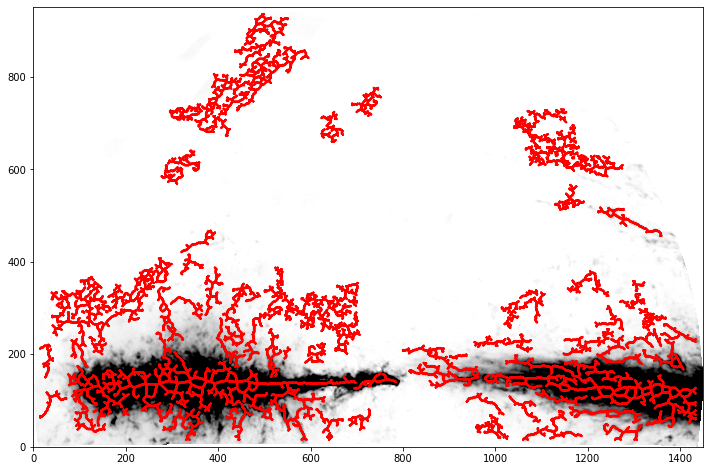

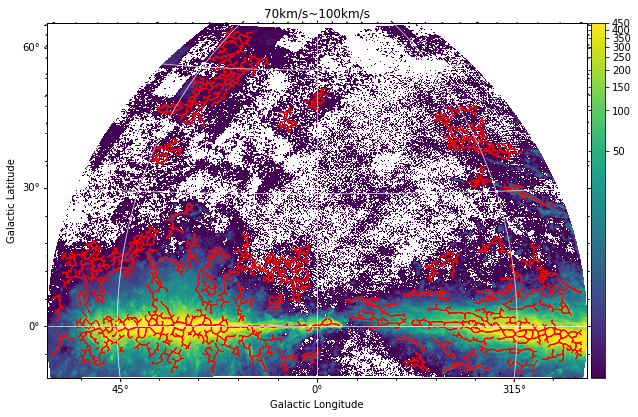

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


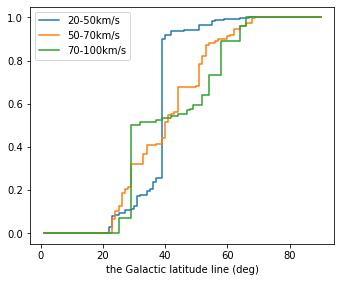

In [62]:
ls = [[20,50],[50,70],[70,100]]
ruiseki_ls = []
fil_to_b = []

fig_ls = []

fig = plt.figure(figsize=(16,16))
for i,j in enumerate(ls):
    
    w = WCS(hdu)


    v_start,v_end,d,bmaj,cdelt,vmin,vmax = j[0],j[1],10,0.2706,0.083333333,1,450
    ##########################
    #     wcs = WCS(hdu.header)
    ##########################


    integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
    integ_hdu.data[integ_hdu.data<=0.01]=np.nan  ####0.01
    hdr1 = fits.PrimaryHDU().header
    hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
    hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
    hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
    hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
    # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
    # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
    hdr1["CDELT1"] = -cdelt
    hdr1["CDELT2"] = cdelt
    hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
    hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
    hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
    hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
    hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
    hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
    hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
    hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
    #     hdr1["BPA"] = integ_hdu.header["BPA"]
    #     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
    #     hdr1["BMIN"] = integ_hdu.header["BMIN"]
    #     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
    #     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



    fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

    fil.preprocess_image(flatten_percent=95)
    fil.create_mask(verbose=True)
    fil.medskel(verbose=True)
    fil_skeleton= fil.skeleton
    fil_skeleton = fil_skeleton.astype("int")
    hdr2 = copy.deepcopy(hdu.header)
    hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    hdr2["NAXIS"]=2
    hdr2["WCSAXES"]=2

#     fig_ = aplpy.FITSFigure(integ_hdu,slices=[0],figure=fig,subplot=(2,2,i+2))
    fig_ = aplpy.FITSFigure(integ_hdu,slices=[0])
    fig_.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
    fig_.add_colorbar()
    fig_.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
    fig_.add_grid()
    fig_.set_title("%ikm/s~%ikm/s"%(v_start,v_end))
    fig_.savefig("/home/filament/Downloads/fil_remake/%s_%i_%i.png"%(fits_pwd.split('/')[6].split('.')[0],v_start,v_end))
    integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)
    fig_ls.append(fig_)
    plt.show()


#     plt.clf()

    fil.analyze_skeletons()
    fil.exec_rht()
    fil.find_widths(max_dist=10 * u.pix)
    total_intensity_arr = fil.total_intensity()

    ypos = np.array([f.position()[0].value for f in fil.filaments])
    
    
    ruiseki = []
    for k in range(1,91):
        c = 0.0
        for j,f in enumerate(fil.filaments):
            if f.position()[0].value<400:
                continue
            pos = w.wcs_pix2world(f.position()[1],f.position()[0],0,0)
            
            if pos[1] < k:
                
                c += total_intensity_arr[j]
        ruiseki.append(c)
    ruiseki_ls.append(ruiseki)
#             pos = w.wcs_pix2world(i.position()[1],i.position()[0],0,0)   #return:(l,b)


#             coo_ls.append(pos)
#             b_ls.append(pos[1])

ax1 = plt.subplot(2,2,1)


ax1.step(range(1,91),ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "20-50km/s")
ax1.step(range(1,91),ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "50-70km/s")
ax1.step(range(1,91),ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "70-100km/s")
ax1.set_xlabel("the Galactic latitude line (deg)")
ax1.set_ylabel("")
ax1.legend()  
        
plt.show()
    
#     coo_ls = []
#     b_ls = []
#     for i in fil.filaments:
#         if j.position()[0].value<400:
#             continue
#         pos = w.wcs_pix2world(j.position()[1],j.position()[0],0,0)   #return:(l,b)

#         coo_ls.append(pos)
#         b_ls.append(pos[1])
        
        
#     b_ls_ = []
#     for i in b_ls:
#         b_ls_.append(i)
    
#     b_ls_array = np.array(b_ls_)
    
#     fil_to_b.append(b_ls_array)
    
    


In [90]:
ls = []
for i in range(-90,1):
    ls.append(i)
ls_ = ls[::-1]


In [92]:
for i in ls_:
    print(i)

0
-1
-2
-3
-4
-5
-6
-7
-8
-9
-10
-11
-12
-13
-14
-15
-16
-17
-18
-19
-20
-21
-22
-23
-24
-25
-26
-27
-28
-29
-30
-31
-32
-33
-34
-35
-36
-37
-38
-39
-40
-41
-42
-43
-44
-45
-46
-47
-48
-49
-50
-51
-52
-53
-54
-55
-56
-57
-58
-59
-60
-61
-62
-63
-64
-65
-66
-67
-68
-69
-70
-71
-72
-73
-74
-75
-76
-77
-78
-79
-80
-81
-82
-83
-84
-85
-86
-87
-88
-89
-90


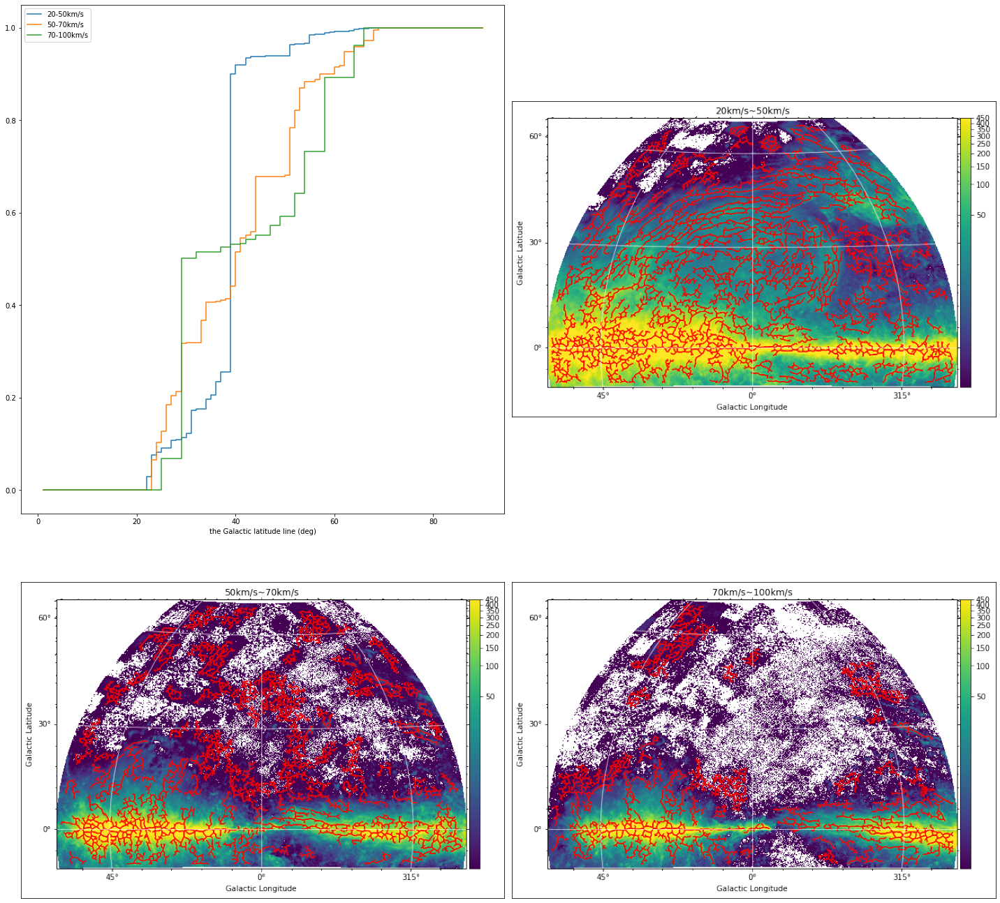

In [64]:
a = plt.imread("/home/filament/Downloads/fil_remake/test_6_20_50.png")
b = plt.imread("/home/filament/Downloads/fil_remake/test_6_50_70.png")
c = plt.imread("/home/filament/Downloads/fil_remake/test_6_70_100.png")
fig = plt.figure(figsize=(20,20))
ax1 = plt.subplot(2,2,2)
ax2 = plt.subplot(2,2,3)
ax3 = plt.subplot(2,2,4)

ax0 = plt.subplot(2,2,1)


ax0.step(range(1,91),ruiseki_ls[0]/np.max(ruiseki_ls[0]),label = "20-50km/s")
ax0.step(range(1,91),ruiseki_ls[1]/np.max(ruiseki_ls[1]),label = "50-70km/s")
ax0.step(range(1,91),ruiseki_ls[2]/np.max(ruiseki_ls[2]),label = "70-100km/s")
ax0.set_xlabel("the Galactic latitude line (deg)")
ax0.set_ylabel("")
ax0.legend()



ax1.imshow(a)
ax2.imshow(b)
ax3.imshow(c)
ax1.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax2.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)
ax3.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)

plt.tight_layout()

In [131]:
a = fil.total_intensity()

In [86]:
a = fil.find_widths?

In [35]:
u.pix

Unit("pix")

In [17]:
fil.find_widths(max_dist=10 * u.pix)

In [18]:
a10 = fil.total_intensity()

In [19]:
fil.find_widths(max_dist=100 * u.pix)

In [20]:
a100 = fil.total_intensity()

In [37]:
fil.find_widths(max_dist=1000 * u.pix)

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


In [39]:
a1000 = fil.total_intensity()

In [44]:
fil.find_widths(max_dist= 20 * u.pix)

In [45]:
a20 = fil.total_intensity()

In [47]:
fil.find_widths(max_dist= 200 * u.pix)

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "


In [48]:
a200 = fil.total_intensity()

In [21]:
a10

<Quantity [4.02027512e+07, 2.33978475e+04, 6.84106855e+05, 1.19325919e+05,
           1.68267578e+05, 1.40311448e+04, 0.00000000e+00, 2.83363488e+04,
           2.46219133e+06, 1.55320270e+04, 4.89941759e+03, 2.33339537e+05,
           9.48650688e+03, 2.21822513e+05, 2.32095644e+05, 9.04238808e+04,
           5.78941175e+04, 2.82708906e+05, 1.48418815e+03, 3.47358745e+05,
           1.41724175e+05, 5.72415091e+03, 5.02305956e+04, 6.27243702e+04,
           3.45664247e+04, 3.72199806e+04, 3.99833939e+05, 3.57926448e+04,
           1.65409213e+04, 6.12829487e+03, 1.79834914e+04, 1.34309585e+05,
           8.19623881e+03, 3.60398789e+03, 1.19469619e+04, 3.65071797e+04,
           4.59858981e+03, 3.90072982e+04, 1.29959326e+04, 1.04165726e+05,
           1.54477323e+03, 1.05181662e+05, 1.07456511e+04, 1.38972724e+03,
           9.20459995e+04, 6.56311034e+04, 1.21652873e+03, 2.45981711e+04,
           4.83293727e+03, 8.09473796e+03, 1.23693699e+02, 5.09474709e+03,
           7.68279697e+03

In [46]:
a20

<Quantity [5.06151991e+07, 2.90391433e+04, 7.45998047e+05, 1.51512927e+05,
           1.70663504e+05, 1.50818180e+04, 1.37040297e+04, 3.47787628e+04,
           3.16686194e+06, 3.25739840e+04, 1.26865308e+05, 6.51116432e+05,
           1.86812588e+04, 3.84527768e+05, 3.22325666e+05, 2.08169095e+05,
           3.41872841e+04, 3.27349723e+05, 2.11378674e+03, 4.75990834e+05,
           1.22382598e+05, 3.15119280e+04, 9.22256221e+04, 8.29978018e+04,
           1.08831304e+05, 1.96184610e+05, 6.82204690e+05, 6.21543750e+04,
           9.29575131e+04, 2.17044680e+04, 4.86645491e+04, 1.10470603e+05,
           0.00000000e+00, 2.41978894e+04, 1.34569707e+04, 2.79951282e+04,
           8.79254629e+03, 8.77432129e+04, 1.10528618e+04, 1.07914932e+05,
           7.13193126e+03, 1.47931568e+05, 1.07456511e+04, 7.32116016e+03,
           9.58409541e+04, 9.80188831e+04, 1.93990844e+03, 7.99980851e+04,
           9.90766322e+03, 8.09473796e+03, 1.23693699e+02, 0.00000000e+00,
           1.47051046e+03

In [23]:
a100

<Quantity [5.60290221e+07, 4.92877734e+04, 9.48869009e+05, 2.74510156e+05,
           1.57093937e+05, 2.03119054e+04, 1.35320397e+04, 3.61152249e+04,
           3.85240769e+06, 4.37543503e+04, 1.34084865e+05, 6.29189508e+05,
           2.49741994e+04, 3.89069525e+05, 3.22325666e+05, 1.78927497e+05,
           3.41872841e+04, 3.54167435e+05, 1.48418815e+03, 7.33836301e+05,
           3.41261238e+05, 3.30145255e+04, 9.22256221e+04, 7.39047912e+04,
           1.66944083e+05, 2.00606874e+05, 6.93143697e+05, 5.54051278e+04,
           9.63736305e+04, 7.65377519e+03, 6.48743242e+04, 7.51827551e+04,
           6.27318061e+04, 1.99760716e+04, 3.95354763e+04, 2.79951282e+04,
           7.03281382e+03, 8.35512845e+04, 6.56544740e+04, 1.30816385e+05,
           1.25092597e+03, 1.33396160e+05, 1.07456511e+04, 1.19848857e+04,
           2.01455489e+05, 1.09966563e+05, 1.93990844e+03, 8.90113869e+04,
           1.21102833e+04, 8.99532254e+03, 1.95308904e+03, 3.99493043e+04,
           2.03716810e+04

In [49]:
a200

<Quantity [5.60290221e+07, 4.92877734e+04, 9.48869009e+05, 2.74510156e+05,
           1.57093937e+05, 2.03119054e+04, 1.35320397e+04, 3.61152249e+04,
           3.85240769e+06, 4.37543503e+04, 1.34084865e+05, 6.29189508e+05,
           2.49741994e+04, 3.89069525e+05, 3.22325666e+05, 1.78927497e+05,
           3.41872841e+04, 3.54167435e+05, 1.48418815e+03, 7.33836301e+05,
           3.41261238e+05, 3.30145255e+04, 9.22256221e+04, 7.39047912e+04,
           1.66944083e+05, 2.00606874e+05, 6.93143697e+05, 5.54051278e+04,
           9.63736305e+04, 7.65377519e+03, 6.48743242e+04, 7.51827551e+04,
           6.27318061e+04, 1.99760716e+04, 3.95354763e+04, 2.79951282e+04,
           7.03281382e+03, 8.35512845e+04, 6.56544740e+04, 1.30816385e+05,
           1.25092597e+03, 1.33396160e+05, 1.07456511e+04, 1.19848857e+04,
           2.01455489e+05, 1.09966563e+05, 1.93990844e+03, 8.90113869e+04,
           1.21102833e+04, 8.99532254e+03, 1.95308904e+03, 3.99493043e+04,
           2.03716810e+04

In [40]:
a1000

<Quantity [5.60290221e+07, 4.92877734e+04, 9.48869009e+05, 2.74510156e+05,
           1.57093937e+05, 2.03119054e+04, 1.35320397e+04, 3.61152249e+04,
           3.85240769e+06, 4.37543503e+04, 1.34084865e+05, 6.29189508e+05,
           2.49741994e+04, 3.89069525e+05, 3.22325666e+05, 1.78927497e+05,
           3.41872841e+04, 3.54167435e+05, 1.48418815e+03, 7.33836301e+05,
           3.41261238e+05, 3.30145255e+04, 9.22256221e+04, 7.39047912e+04,
           1.66944083e+05, 2.00606874e+05, 6.93143697e+05, 5.54051278e+04,
           9.63736305e+04, 7.65377519e+03, 6.48743242e+04, 7.51827551e+04,
           6.27318061e+04, 1.99760716e+04, 3.95354763e+04, 2.79951282e+04,
           7.03281382e+03, 8.35512845e+04, 6.56544740e+04, 1.30816385e+05,
           1.25092597e+03, 1.33396160e+05, 1.07456511e+04, 1.19848857e+04,
           2.01455489e+05, 1.09966563e+05, 1.93990844e+03, 8.90113869e+04,
           1.21102833e+04, 8.99532254e+03, 1.95308904e+03, 3.99493043e+04,
           2.03716810e+04

In [25]:
len(a10),len(a100)

(123, 123)

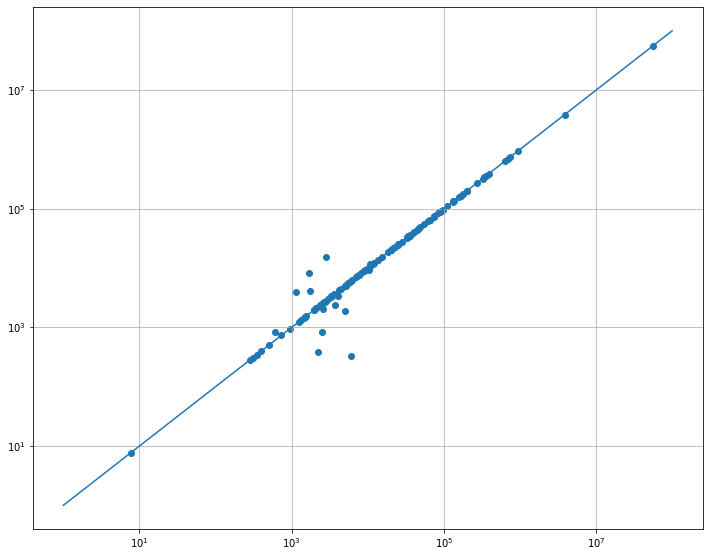

In [77]:

plt.scatter(a100,a1000)
plt.yscale("log")
plt.xscale("log")

plt.grid()
plt.plot([1,1e+8],[1,1e+8])


In [27]:
fil_b = []    
for i in fil.filaments:
       
    pos = w.wcs_pix2world(i.position()[1],i.position()[0],0,0)   #return:(l,b)
    fil_b.append(pos[1])

In [28]:
fil_b = [f.position()[1] for f in fil.filaments]

In [29]:
df = pd.DataFrame({"intensity_10":np.log(a10),"b":fil_b})

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/astropy/units/quantity.py:486: RuntimeWarning: divide by zero encountered in log
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)


In [30]:
df

,intensity_10,b
0,17.509446,928.0 pix
1,10.060399,1462.0 pix
2,13.435869,1174.0 pix
3,11.689614,733.0 pix
4,12.033311,1385.5 pix
...,...,...
118,5.907446,602.5 pix
119,5.440862,537.0 pix
120,7.701687,380.0 pix
121,2.039770,524.0 pix


<AxesSubplot:xlabel='b', ylabel='intensity_10'>

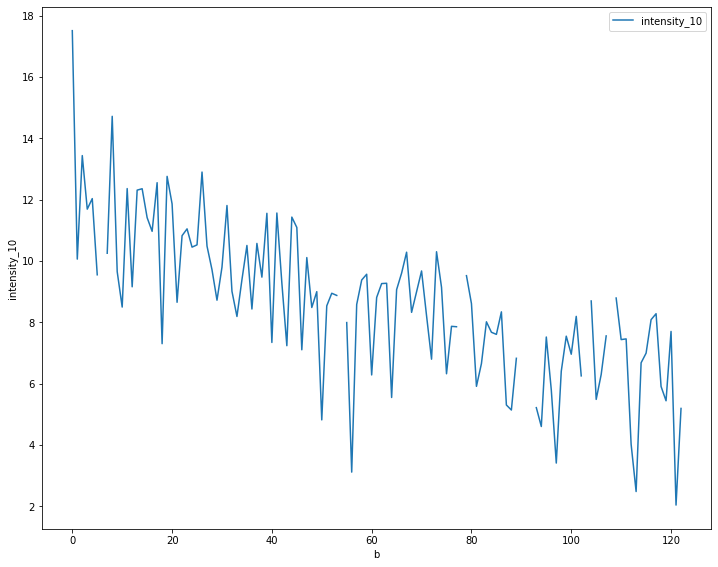

In [31]:
df.plot(xlabel='b',ylabel = "intensity_10")

In [32]:
fil.output_table()

lengths,branches,total_intensity,median_brightness,orientation,curvature,X_posn,Y_posn,amplitude_0,amplitude_0_err,stddev_0,stddev_0_err,amplitude_1,amplitude_1_err,fwhm,fwhm_err,fail_flag,model_type
pix,,,,rad,rad,pix,pix,,,pix,pix,,,pix,pix,,
float64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,bool,str12
1448.1189744953674,350,56029022.14823885,665.629733118149,-1.5579765990706949,0.5833118413231464,928.0,144.0,613.705919477865,375.1415109714133,6.9692144271075405,32.0,30.396846367330884,76.12934859522029,16.086785937641938,76.87408693667861,True,nonparam
194.13761854251328,7,49287.7733555112,11.22888405062248,-0.6785446360216717,0.819833689180188,1462.0,94.0,5.798720266118501,0.2067113310818885,12.468800681042058,0.5366110664606258,1.1309288374662019,0.1609748331077536,29.18167098442514,1.2714216396995814,False,gaussian_bkg
135.095454429505,10,948869.008892959,400.1435997579283,-0.9397089831051744,0.8607589296166815,1174.0,73.0,401.59327630822685,197.01688815546984,5.261123334124883,23.345235059857504,99.59881502551795,41.48811740320142,11.955876401655399,56.96534938154013,True,nonparam
88.18376618407356,3,274510.15588912036,175.05915284467164,-1.1200627191273929,1.0047282318676687,733.0,63.0,174.76010322518556,26.192095905673888,7.757799645148451,23.021728866442675,34.20704140444932,1.3944466477531212,17.97730878429965,55.089301267258435,True,nonparam
106.08326112068524,4,157093.93716380783,122.0472648655049,-1.5447363852124048,0.9960593406895248,1385.5,83.0,140.209785869882,67.61188365362848,5.259417095321531,23.345235059857504,11.556252452909014,4.730062024860604,11.951712911661172,56.96671287872476,True,nonparam
49.2842712474619,1,20311.90541082318,38.9075362037396,-0.996765620332514,0.7527565499055626,559.5,59.5,37.07330797716426,12.67594724840224,5.786976069138688,35.4400902933387,5.455969376746569,0.4313270125442213,13.234751595990662,85.93026671063906,True,nonparam
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199.12398189253247,18,5515.397560101986,1.5371170003909103,1.0403815622633952,0.49940062110913575,1015.5,828.0,1.4641457846838792,0.56690627718265,4.919729678862448,90.60905032059435,0.3843414030984774,0.05039097968286368,11.120689089383896,222.27804488074835,True,nonparam


In [ ]:
math.asin(/2000)